In [1]:
import os
import pandas as pd
import Bio.PDB.PDBList as biopy
import PCN
import traceback
import tarfile
import random
import numpy as np
import networkx as nx
import MDAnalysis as mda
import random
import Bio
import matplotlib.pyplot as plt
import esm
import torch
import os
from Bio import SeqIO
import itertools
from typing import List, Tuple
import string
import MDAnalysis as mda
from sklearn.metrics import accuracy_score,f1_score
torch.set_grad_enabled(False)


## Helper Functions for ESM-1b

In [2]:
deletekeys = dict.fromkeys(string.ascii_lowercase)
deletekeys["."] = None
deletekeys["*"] = None
translation = str.maketrans(deletekeys)

def read_sequence(filename: str) -> Tuple[str, str]:
    """ Reads the first (reference) sequences from a fasta or MSA file."""
    record = next(SeqIO.parse(filename, "fasta"))
    return record.description, str(record.seq)

def remove_insertions(sequence: str) -> str:
    """ Removes any insertions into the sequence. Needed to load aligned sequences in an MSA. """
    return sequence.translate(translation)

def read_msa(filename: str, nseq: int) -> List[Tuple[str, str]]:
    """ Reads the first nseq sequences from an MSA file, automatically removes insertions."""
    return [(record.description, remove_insertions(str(record.seq)))
            for record in itertools.islice(SeqIO.parse(filename, "fasta"), nseq)]

def load_ESM_1b():
    """ Download the ESM_1b model and initalizes it."""
    esm1b, esm1b_alphabet = esm.pretrained.esm1b_t33_650M_UR50S()
    esm1b = esm1b.eval().cpu()
    esm1b_batch_converter = esm1b_alphabet.get_batch_converter()
    return esm1b,esm1b_batch_converter

## Data for Contact Map Analysis

#### The query for obtaining the list of PDB_IDs are as follows:
<a href="https://www.rcsb.org/search?request=%7B%22query%22%3A%7B%22type%22%3A%22group%22%2C%22logical_operator%22%3A%22and%22%2C%22nodes%22%3A%5B%7B%22type%22%3A%22group%22%2C%22logical_operator%22%3A%22and%22%2C%22nodes%22%3A%5B%7B%22type%22%3A%22group%22%2C%22nodes%22%3A%5B%7B%22type%22%3A%22terminal%22%2C%22service%22%3A%22full_text%22%2C%22parameters%22%3A%7B%22value%22%3A%22kinase%22%7D%7D%2C%7B%22type%22%3A%22terminal%22%2C%22service%22%3A%22full_text%22%2C%22parameters%22%3A%7B%22value%22%3A%22crystal%20structure%20%22%7D%7D%5D%2C%22logical_operator%22%3A%22and%22%7D%5D%2C%22label%22%3A%22full_text%22%7D%2C%7B%22type%22%3A%22group%22%2C%22nodes%22%3A%5B%7B%22type%22%3A%22group%22%2C%22nodes%22%3A%5B%7B%22type%22%3A%22terminal%22%2C%22service%22%3A%22text%22%2C%22parameters%22%3A%7B%22attribute%22%3A%22rcsb_entry_info.resolution_combined%22%2C%22operator%22%3A%22range%22%2C%22value%22%3A%5B1%2C1.5%5D%7D%7D%5D%2C%22logical_operator%22%3A%22and%22%7D%2C%7B%22type%22%3A%22group%22%2C%22nodes%22%3A%5B%7B%22type%22%3A%22terminal%22%2C%22service%22%3A%22text%22%2C%22parameters%22%3A%7B%22attribute%22%3A%22entity_poly.rcsb_entity_polymer_type%22%2C%22operator%22%3A%22exact_match%22%2C%22value%22%3A%22Protein%22%7D%7D%2C%7B%22type%22%3A%22terminal%22%2C%22service%22%3A%22text%22%2C%22parameters%22%3A%7B%22attribute%22%3A%22rcsb_entry_info.resolution_combined%22%2C%22operator%22%3A%22range%22%2C%22value%22%3A%5B1%2C1.5%5D%7D%7D%5D%2C%22logical_operator%22%3A%22and%22%7D%5D%2C%22logical_operator%22%3A%22and%22%2C%22label%22%3A%22text%22%7D%5D%7D%2C%22return_type%22%3A%22entry%22%2C%22request_info%22%3A%7B%22query_id%22%3A%2213e2ed91c000ae1a14db66b7028d506d%22%7D%2C%22request_options%22%3A%7B%22pager%22%3A%7B%22start%22%3A0%2C%22rows%22%3A25%7D%2C%22scoring_strategy%22%3A%22combined%22%2C%22sort%22%3A%5B%7B%22sort_by%22%3A%22score%22%2C%22direction%22%3A%22desc%22%7D%5D%7D%7D">Search Query</a>



In [36]:
query_res="3KHF,3LQ3,3FEG,6YA6,2WWE,2IIM,4L0N,3WAR,2X18,7A22,7A1Z,7A2H,7A1B,1WYX,6Z19,3M9J,4YPD,6ELM,7D0E,2YJC,6YZH,6GY5,5JJ2,7CCW,2HSH,6RCH,6RCG,1KGD,3TW2,3O46,3I4W,6TSE,3S4E,3G36,6EGE,2QT1,6HOG,2QFA,2C60,2XRW,5GJH,6G9Z,5O8I,1LKK,4N6X,3ZYQ,2C01,4RFZ,3L46,5EP6,1EAZ,6KC4,6KEC,6KEI,5K26,6TT2,4EIH,5NP5,6B9X,3FIA,4LMM,2R3R,2R3I,6HOL,6J5S,5ED3,6TEW,4FKL,4EK4,4EK3,4P5Q,6HMB,6HMC,6HMD,4LDJ,4OBE,3LNY,3WA4,1OBX,5P21,5XRD,4YDP,4FH0,7F0W,6ZBK,3EAZ,3EAC,6Q4Q,5AUL,7L9M,6SRH,7M10,6Z36,6B42,5WA8,5WA9,5LR1,5XRE,5NYI,3Q6L,4MPA,2R3Q,2WP3,4RRV,6I5H,7REK,5W55,2BRF,4GRZ,3CZT,4N19,6VJJ,6G36,6HOI,5J1S,2YJ2,2YJ9,2YJ8,2YJB,2IZX,5ZCK,4FKU,5J1T,2OVJ,6RQW,6RQQ,6J65,6DMJ,6HYO,7AJN,6SE4,6S25,5O97,6ZED,6ZEL,6ZF9,6I7Y,6I7X,5E0R,4JL7,4Q3H,5KJZ,3K05,6ZVO,4HYI,5Y90,2NZL,2PEZ,2HC1,2HC2,7CIO,5FTG,6Y1J,1XD3,6J5Z,3CJW,6TGK,6HMT,2GCO,6FT8,5LXI,6G39,6G3A,4XX9,3BBB,6G37,6G38,5W2F,2VIF,6FBB,5KLY,5KM4,5XCO,6AC0,6FNI,4C6K,4C6J,4C6I,4C6F,4C6E,4C6D,4C6C,6FNK,6FNL,6FNJ,4X3K,1NTE,5J80,5J64,7AEW,6FCP,5P9K,4HCV,4HCU,4HCT,3KZD,2RGG,6Y8E,2A2A,7A2N,6QUW,6QUV,2FE5,3O3U,7A2S,7A2T,7A2R,7A2Z,4XOF,3KNB,1M9Z,1WMA,6FNM,6ZJE,2YEX,7NDY,2UV4,3MHR,3K82,7AAH,4HZR,4E1H,7B8H,6NMW,6QUU,4QTC,5HHE,5IO9,1W70,6ZRN,4BB9,5YWR,1GP0,6XXX,1D4T,4ZX2,1W1G,6G6K,3IQJ,7NPG,7NPB,7NP2,7NND,3A7I,4UU5,6M64,3NSZ,4QLI,6T29,7LB1,3GU6,3GU4,2OSS,3EYI,3U5L,1W1H,3G4E,3UVW,5DC4,6M5Y,5VBM,4KS7,5NNF,6H5W,2A2R,2OUR,4Y5I,5AV4,4DHR,7L9G,1WMS,1H8D,5ZN0,5ZN1,5ZN2,5E8X,3IQV,3IQU,6MV4,5J2X,4D3P,5DQY,5EOP,3CO1,7LAY,1PWA,5MSA,5KM2,4PF4,3BHY,3OT3,2DKO,3AJ4,6N7A,6S17,6S1B,6S1J,6S1H,6S14,3PA3,5CVG,5CSV,5OGJ,3L8Z,3TGP,2AFY,6LCB,5NNG,5CU6,1I73,1TGR,7REE,6YIA,7LL4,5E8S,5DK8,5D7F,2GBJ,6V6U,6V6V,2WWZ,1OKI,1PA7,4KWP,3BUX,4WNJ,3OBQ,2RGB,2RGE,5MOH,3W80,3TT8,5QU7,5QU4,5QU3,6V6M,5S9B,5S9C,5S9A,5S9J,5S9H,5S9I,5S9F,5S9G,5S9D,5S9E,5S92,5S93,5S8R,5S90,5S91,5S8Y,5S8Z,5S98,5S8W,5S99,5S8X,5S8U,5S97,5S8V,5S94,5S8S,5S95,5S8T,3EY6,5ELQ,5OHH,7B13,4O71,6L1S,6LVQ,7C8S,6QJL,6QJK,5OUL,5OTQ,5OTY,5OTZ,6EHK,5H8X,1UZK,3P34,7S5A,4LM4,4LM3,2QUZ,1MFG,6BLN,6BKW,6PCL,6PCK,3SOV,5NK5,5NK6,5NK4,5NKA,5NKG,5NKH,5NKE,5NKF,5NKC,5NKD,4PQW,6FNG,6FNH,4RX5,6Q7C,6Q7B,6HEY,6Q7G,6Q7E,6Q7F,4HJP,3F66,5MXO,4WOH,1I76,5KUP,4XZF,6HEX,6HEV,6HEW,6HET,6HES,6Q3Y,4YLL,4YLK,4PS5,5QU1,6HRP,6HRT,6DI9,6DI5,5U9D,5E95,6DI0,6DI1,1KQ6,6X3P,3P1N,5L0S,4O7A,4O74,4O72,4O78,3TEM,6PKF,4CY7,6ICG,6TC2,4U7H,5NNE,5MME,1XOZ,1S1P,5OAZ,4Q26,5I9Y,6QHL,6UYZ,6V7S,6V7Q,5I9X,4UEH,5MYC,5MY9,5VBO,5I9V,7AV9,7BBO,4LYH,5WA5,6CJ2,6CD4,5I9W,1LF7,6GD3,6AC5,7L73,6J6M,6HFI,6HFE,3GJ0,4LUC,6HFU,6HFK,6HFL,6HFJ,6HFH,6HFS,6HFR,4X9J,5A1I,1TBF,6KUG,6E4F,6TJQ,4ZGG,3T0H,7RT1,7RT5,5P9M,5P9L,5P9I,5P9J,4J46,4J45,4J44,4J47,5S9K,5S8A,5S81,5S7N,5S7L,5S7M,5S7K,5S7Y,5S7W,5S85,5S7T,5S86,5S83,5S84,1WM3,1MH1,2VXT,5EMA,2B69,6HFP,6HFN,5F2E,7S6O,6OC0,6PHQ,6PHM,6PHN,3BER,3GHU,3GHT,3GHS,3GHR,3Q1I,3WHA,3B28,4QL3,4TQ9,4TQA,5YOV,6FQO,6FQU,5OWK,5EP7,5ENG,5MPN,5MMG,6O5W,6HFQ,6MJ7,5F62,5F63,5F60,5F61,4GA0,6W2G,4UFD,4M1Y,6MBU,4X2I,7C2Z,5LRL,6OLX,6N8X,4JV8,6FBW,5S7Z,5S7A,5S7H,5S7I,5S7F,5S7D,5S7E,5S7B,5S7C,5S7P,5S7O,5S7J,5S89,5S7X,5S87,5S7V,5S88,5S7R,5S7S,5S78,5S76,5S77,5S75,5V9U,6XXJ,6B0Y,5LVN,6FJT,5KM3,4J9E,4J9C,4BW1,6V0U,4J9F,7NFB,4CFL,4QC4,2X2A,6BOF,6P0J,1PIN,6P0K,6P0L,6HH2,3U2C,5KM9,4QBV,5KYC,6FAV,6FAW,6FAU,6PHO,6PHL,6PHI,4EO7,4ONM,5GOD,5GOB,5W7W,2OUS,6EDF,4QR5,4QR4,4QR3,4NUC,4NUE,4NUD,4UDW,4UE7,4UD9,5AHG,5AFY,5AF9,6FT3,6FT4,6FSY,6VUJ,4PCI,4PCE,6ZB3,6CZU,6PS9,6PRT,7O6K,7NSV,7O3A,7O3F,7O3P,7NR7,7NMH,7NLE,7NM3,7NK5,7NJB,7NK3,7BIQ,7BI3,7NYG,7NYE,7NZ6,7RXR,7RXS,4IOR,4IOO,4QZS,6AJV,6AJW,6VRD,6MBT,4J3I,5M39,4LYI,7MLS,7MLR,7MLQ,6YQO,6YQP,6YQN,5DW2,3T10,5D0C,4YH4,6E4A,5HM0,4Z1S,4Z1Q,6RWJ,6S6K,6U0D,6XUZ,6XVC,6XV3,6B0V,6G0R,4AW0,5J41,6ODG,6SZM,6G3R,6Y1E,5PYW,5PXB,5PXA,5PXL,5PY5,5PXT,5PXS,5PXN,5PWG,5PWF,5PX4,5PWS,5PX2,5PWR,5PX6,5PWU,5PAG,5PAV,5PAS,5PB2,5PAO,5PAX,5PAE,3T7L,6B1K,6B29,5V1Y,2GRR,5Z1S,5Z1T,6BCB,6CYH,5ENA,6HMU,2PPO,3BFO,6B26,2Y5F,2Y5H,2Y5G,5GWN,4EY1,4EY9,4EYD,2ERF,5QID,5QIE,5QIC,5QIH,5QIF,5QIG,2FGB,1ZQ5,5KYF,6YIM,6YIL,4NYW,4NYX,4NR7,5UG8,5UG9,7PBB,1Z70,3G9Y,6PHK,6LJW,6LJV,6LJT,4YUH,4YUG,4YUO,4YUL,4YUK,4YUJ,4YUI,6P7Z,6MBQ,7KTE,5WMJ,6GJ5,4XO6,4GQ4,4GPQ,4OG4,4OG6,6O53,4C9X,3EG3,5LMA,6DJC,5XHE,5KU3,5NWD,5NWG,7ROV,3I3S,5Y8C,6SQO,3RFE,4DLR,5KHM,6XDS,2FST,4WY4,5QU5,5HPR,5HGZ,6P0Z,6D31,2OMH,2ZHN,2FZD,4ONL,2X5Y,4JMG,5INB,4F3I,4YLQ,6R2W,2CLD,2CLC,2CL7,2CE2,2I5F,5GH9,2W73,1R8S,5V37,6TX8,4U1M,3ZM1,2HE4,5QU2,1P5F,2FR3,4J3Y,4UP0,4GRN,6G0S,2FZ8,7KT5,1CTQ,3BUW,7K5L,6G0P,4WJQ,5OCG,5M9O,2CL6,2EVW,6G0Q,3RS0,5C2K,7NEL,6G0O,5XCT,5XCQ,7KHL,5JFD,6T56,6T55,6T53,6YQV,6YHG,5A2M,6TKL,6TKG,6Y02,6VAJ,2ZQT,3Q27,6IPY,5F6Y,5F6V,5F6E,6HXU,4DRI,5HG8,4GR8,3PP2,6PAF,6G2N,4KNN,2ITK,2E3N,2E3P,7AVC,7ER8,2C9S,2C9U,2C9V,4HY4,1DG6,4AG1,3NCL,7KG8,4QUJ,5CQ2,3SJM,6QW3,6NV2,6QHM,5MM6,5MJT,5I88,5KTU,4FYO,5MPZ,5MQG,6I44,5B4O,5TIU,4PZ3,6RL3,5R8B,5R8A,5R8K,5R8I,5R8F,5R8G,5R8D,5R8E,5R8Q,5R8N,5R8O,5R8M,5R88,5R87,5R85,5UQA,1MFM,5COY,3UGC,3TOW,6O24,4JJE,3VXE,1OGW,1Z89,6TNQ,7NHU,2H3L,5NI9,5NIG,5NR4,4IUM,4N7F,5YQO,3SI4,6T4A,6T3Q,5LCE,3RMO,3RM2,3RM0,3QX5,3SV2,3T5F,5NL4,2UUJ,2UUF,2UUK,2CN0,3SXE,6Y3V,3H61,3H63,5UGG,5UGD,3H62,1I27,4IGH,6I42,5HKJ,3AP9,4LNP,4LN2,6BCD,5L0T,4NIB,5HRQ,1BKR,5TXY,5KFS,5KFN,7M7N,7M7M,7M84,7M7T,4HF3,6P0I,7RNU,6NSV,7NX1,5S8I,5S8J,5S8G,5S8H,5S8E,5S8F,5S8C,5S8D,5S8P,5S8M,5S8N,5S8K,5S8L,5RKU,5RKV,5RKS,5RKT,5RKQ,5RKR,5RKO,5RKP,5RKY,5RKW,5RKX,5RK5,5RJT,5RK6,5RJU,5RK3,5RJR,5RK4,5RJS,5RK1,5RJP,5RK2,5RJQ,5RJN,5RK0,5RJO,5RJZ,5RK9,5RJX,5RJY,5RK7,5RJV,5RK8,5RKE,5RKF,5RKC,5RKD,5RKA,5RKB,5RKM,5RKN,5RKK,5RKL,5RKI,5RKJ,5RKG,5RKH,5RJL,5RJM,5RJJ,5RJK,5ENE,5ENF,4DJC,4DAT,4INC,3LW1,1UNR,1P1V,2VR6,1OZU,3SXB,3SX8,3SX5,6LJE,4EEW,4WZX,2IKG,2IKI,7JGW,4GV1,6KX2,3WLU,4ICV,4OQV,6HYN,3CBP,4WK9,4WKH,4WKF,6XLV,4WJO,5UDP,5E50,1X96,1X98,3ONB,3ONC,2QJZ,4UZ1,4WW6,6XXC,6XY5,6Y18,6UYV,5KFZ,7MU3,5SYA,5SY9,5SY6,4P2G,3CZA,7AA7,6V1B,7RNS,6MX3,3HJ0,5MHC,4HI9,4HI8,4FRA,7B37,7ARG,7B3F,5W46,4P36,3CZ9,3CY6,2F3Y,7NYO,7NYK,5UUI,7QHG,4QSB,6Y3W,6Y1D,4PZH,4Q08,5N5W,3MC5,3M64,3M0I,3LEN,7O07,4DO4,4MZI,6FYR,3F1P,2IZR,7BRQ,5JNT,6L0X,6F4Q,7LIP,6D30,6D2Z,5JIX,6RJL,6RHC,7BF2,5NXI,6EIM,5JGI,5C7G,4U3Y,5CMM,6R8R,6GRO,2UYZ,7ABT,1QTN,1ZD8,4YPC,4YBM,5KH9,5B8D,4JJ7,3EWY,3EWX,4GAI,7AZ1,7AZ2,7AXN,7BG3,3MRK,5KTW,5KTX,6RA7,4NFN,6FEW,3DN5,5J0D,1T41,5MFA,5L0N,6TUZ,4OUF,2PIE,4QX5,2W4J,5I83,5I89,5I86,2WZB,3ZZY,4GWG,6MYE,5JAX,5J48,2QOC,3FED,2QOI,2QOK,2QOL,2QOO,2QOD,2QOF,5OQ5,6HB9,6FEX,3U9W,7L8Q,6B6U,3DJH,6N6K,5G4M,5G4N,7BF1,6FVF,3F1N,2VR8,7AT9,6ZEI,5FAF,6QHJ,6G8L,6G8J,6G8K,6G6X,6GUK,1MKK,6TLS,5QIT,5QIR,5QIQ,5QIO,5QIX,5QIV,3HSV,6AY5,4R1V,7SUG,7SUF,4P2K,3ZCL,6XZZ,6XYX,7PD9,5THN,6Q4F,6Q3F,6Q3C,6OMU,6Q4H,6Q4I,6Q4D,6Q4E,6Q4B,6Q4J,6Q4K,6Q3B,6Q48,6Q49,4HBQ,3MI2,6Q4A,5A7G,5YP8,6FCH,2VZC,6ESM,5LCP,7B9T,7B9R,7BA8,7BA7,7BA9,7BAB,7BAA,7BA3,7BA6,7BA5,7NIZ,7NFW,5M6V,6O8I,6G5P,7KSW,5M71,5M6Y,5M0L,5LCQ,5LBZ,5LBY,7L67,7L64,7N5O,7KXM,7KXQ,7KXN,1H10,6OSH,6OSN,6OSV,4GCJ,6E28,1GK7,1Z0J,5MHQ,5TZM,5EHW,5EHV,6R8P,6TJT,6ZTB,7KT0,7KSZ,5KO0,6VXQ,4CT2,6NFH,5ACK,5YVN,1GZ8,7B2V,7B2Y,5LVL,5YP7,3SX7,3SX3,5LVM,6SI3,6SI1,6SHZ,7OFV,4XCT,5W3R,3CBZ,6O4J,5WAA,2V0A,6ZK0,3I0G,5ZMZ,6YQM,5BXC,5C49,5LVO,3FEC,7PB5,7P9R,5LO5,5MRD,2YI7,3NHE,1LZI,1LZJ,7RXV,4XJJ,6TN5,6TN4,6W2I,3MYQ,3D06,3D08,7LIN,6YHA,5G4O,6V4F,5LL4,6N6I,1RG8,4RI5,6YQ2,6YPY,6YOW,7O6M,7O6J,7NV4,7O6O,7O57,7O59,7NQP,7O34,7NLA,7NM1,7NJ9,7BKH,7BJF,7BJL,7BJW,7BIW,7NZK,7NZG,7NZV,7NYF,7NXW,7NXY,7NY4,7NXS,7NXT,7NWS,7NVI,4N12,7KT2,4OQ4,5JO3,7KTG,7KTN,7KT9,3EZG,1SOA,4BCY,6YOJ,7LH7,3SP7,4X2F,6N3X,6N3V,3OIU,3OIW,4EPV,6GPO,7RPZ,1UYL,5BN8,6PQA,7A1X,6MS9,3VHA,2CIA,4BTE,4PQD,6E5Z,4S0Z,4MTC,3VHC,2YKJ,2YKE,2YK9,3O0I,2OR3,3F71,6GQS,6GR5,2GZV,6AX4,4N1M,4N1S,6HXM,6HXL,4Z93,3WUZ,4LR6,5KMC,4Q27,4Q2F,4Q1R,4Q1P,5MWX,6G0D,7NZD,7NZC,5K7N,5DRS,3FF3,6QL2,6QL3,6O5I,6MQT,1L3K,4U1P,5M33,6T5B,6T5V,6TAN,4QTA,6ZCS,5J0F,4PZZ,4Q03,4Q01,4X9V,4X9R,6G0G,6BQA,4ZZN,3K0N,3K0M,5TA2,5T9Z,5V5C,6GGF,5O1I,6GGC,6GGD,6GGB,5O1G,5O1D,5O1E,5O1B,5O1A,5O1H,5AOK,5LUD,5NOY,5NOW,5NOX,5NOU,5NOS,5NOT,6TKK,6SLG,6X3Y,2X25,5WC7,5F66,4PWQ,3GP2,5MYX,5WP1,6GJL,6GJM,6GJJ,6GJY,6GS6,6AR0,4QTB,4YJR,4YJQ,5I2F,7B4N,7B49,7B4H,5UF0,6GBI,5AD3,4O6W,6YQZ,4HXS,4HXN,5CFW,6AJZ,5EI4,6SWN,4UIZ,4UIY,4CL9,6Z7M,6DL2,5A5S,1T7H,4UYD,6UWX,6UVJ,4CFQ,6TS3,7JKY,7JKX,7JKW,5LJ2,6FNX,7A9U,5XI4,6JJ5,6JJ6,7M16,7P6W,7P6V,4WHW,5S96,4Q7Z,5QS8,5QS9,5QSJ,3U2U,7LCU,3P6C,1X97,4XZH,4QX4,1PWL,4OEL,5IPC,5IPE,4GGC,3K8Y,4AOH,4GRR,4GRP,6YF2,6YF3,6YF1,5M9Q,5M9R,5MG7,5MCT,5WDQ,5WDP,6RWU,5H5Q,5H5R,4TNS,2RJ5,4A3P,7AC9,5EDC,5EDB,6YVK,6YVN,6YVL,6YVM,5I80,5HZ6,5HZ8,5N20,3RZY,3P6H,3P6G,3P6F,3P6E,3P6D,7KTF,5Z02,5ZXF,6FVH,6FVE,6TPZ,6TPX,4CFR,3I6C,3IJJ,5WMA,5WMG,5WMD,3TC5,5HGJ,6GX2,5NJ9,5NJA,6T52,6T3M,3U98,6I51,6YSJ,6YN3,6YMP,6YHJ,6YB6,6Y9H,5IBP,6GMC,6GMB,3EXX,3W7Z,6VET,4X5W,6S34,6VER,4XC4,5USV,5UU2,5URT,5USP,5UOZ,3U8R,4AJX,4R0U,6GV0,5I29,2BVR,2BVS,2ZFF,6OD3,4ZNN,4RIL,5C4M,2JKH,4QKZ,2J30,2J32,3KL6,5SVY,4FKA,6GBW,6ROT,5JZY,3P17,5R7W,6Y8I,4HK2,5NHU,6YSX,4IBY,5A7B,4AGQ,4AGO,3U8O,1HE4,5BT3,6NE2,5WL1,4GQR,4Z47,1C5L,2CF8,6SBO,6VIG,5C0F,5NVG,1J96,5L0V,2I7D,5TXD,3PZZ,3Q2X,5TOG,7CAP,4JTR,4JQA,6D3Y,5VOS,7KJM,1KJL,6UYR,6UYP,6OIZ,6NB9,5TOF,6T5G,6T27,6IBE,6X8H,4PUW,6TUF,6TUC,2AXI,6YBM,4Q2Q,6K39,5ONQ,5ONR,5ONP,5HOB,4D6A,6Q0M,6Q0N,6F4P,2RK6,5HOC,6T7Q,2AGT,3T42,3LZ3,3LQL,3LD5,3LBO,4NIN,6F8O,6F84,6F82,4OWZ,6BXX,2RK4,2RK3,2R8U,5EH7,5EH8,5EH5,6AFC,6AFJ,6AFD,6AF9,6AF7,2WD2,4CQ0,6GL8,5RJI,3MRG,6ZEG,5UL6,3D25,2WNV,4NIO,3UVC,5YBY,4ZSD,5CBT,6ALC,6F78,5I8G,5V8Q,6AY3,6AXQ,5W0E,6RT6,6RT4,6EW6,5ZGD,4GYX,6UGO,6I3E,6X8O,6E78,6E72,6T2K,6T2H,6SJA,7B9N,7B9I,7B84,7B7Y,7B86,7B8C,7B8A,7B8L,7B8M,7B45,7B3G,7BDA,7BDF,7BDC,7BDB,7BDD,7BD8,6ZVL,6YXI,6PJV,3SGP,6YSK,6TR7,6TR6,4OHA,5C5A,3ZME,5TZL,4A7V,4A7T,4A7S,4A7Q,4A7G,2WYT,6Z3V,6Z4G,6Z4O,6Z4K,5O3Y,6GGE,5O1F,5O1C,5AOJ,5AB9,5LAP,6MS7,2XJK,4WT2,4OGN,7KKN,2IFQ,3GZQ,5O5T,5OF0,4RMI,4RMH,4GQQ,2RJ4,4AVS,3D32,7AES,5EXN,2PZN,4QR6,4Q7B,4PUU,4RPQ,4YU1,4PRR,4PR4,4NKC,2PQ8,6YIP,4M5S,1RYO,4YS1,6D40,2PDG,2PDH,2PDL,1Z3N,3LQG,5KL3,4PK3,4PK2,4Q6S,2XG3,4UE1,1A7S,6HN3,7NUS,6Q9L,6Q9O"

In [37]:
pdb_list = query_res.split(",")

### Download corresponding PDB Files and store it in a directory

In [ ]:
pdblist = biopy()
PDB_IDs = pdb_list
counter = 1
for PDB_ID in PDB_IDs:
    print(f'At entry {counter} out of {len(PDB_IDs)} entries.')
    pdblist.retrieve_pdb_file(pdb_code = PDB_ID, file_format = 'pdb', pdir = './data1/test1/')
    counter += 1

### Download corresponding Files and store it in a directory

<a href="https://www.rcsb.org/downloads/fasta">Use this link to download all FASTA files by providing the list of PDB IDs</a>



## Comparative Analysis of Contact maps- ESM_1b  and PDB Structure

In [40]:
def getContactMap_fromPDB(PDB_file):
    """ Takes a PDB file and creates a PCN from the alpha carbons and computes distance matrix 
    followed by generating a contact map with 8.0 Å threshold value."""
    protein_contact_network = PCN.PCN(PDB_file)
    C_alphas = protein_contact_network.get_C_alphas()
    chain_length = protein_contact_network.get_chain_length(C_alphas)
    if protein_contact_network.get_link_lengths(C_alphas) is not None:
        distance_matrix=protein_contact_network.get_link_lengths(C_alphas)
        contact_map = distance_matrix >= 8
        contact_map=np.multiply(contact_map,1)
        return contact_map
    else:
        return None

In [41]:
def getContactMap_fromESM(esm1b,esm1b_batch_converter,fasta_file):
    """ Loads the ESM_1b model, computes contact map from the inputted FASTA file. """
    esm1b_data = [read_sequence(fasta_file),]
    esm1b_batch_labels, esm1b_batch_strs, esm1b_batch_tokens = esm1b_batch_converter(esm1b_data)
    esm1b_batch_tokens = esm1b_batch_tokens.cpu()
    esm1b_contacts = esm1b.predict_contacts(esm1b_batch_tokens).cpu()
    seqlen = len(esm1b_batch_strs[0])
    #contact_map=esm1b_contacts[0][:seqlen, :seqlen]>=0.1
    contact_map=esm1b_contacts[0][:seqlen, :seqlen]>=0.1
    contact_map=contact_map.numpy()
    contact_map=np.multiply(contact_map,1)
    return contact_map

In [42]:
def compareContactMaps(contact_pdb,contact_esm,pdb_name,results_path):
    """ Compare contact maps generated by ESM_1b vs PDB and compute accuracy."""
    print(contact_pdb.shape[0],contact_esm.shape[0])
    if contact_pdb.shape[0]==contact_esm.shape[0]:
        contact_pdb_upperTraingle=contact_pdb[np.triu_indices(contact_pdb.shape[0],k=1)]
        contact_pdb_upperTraingle=np.multiply(contact_pdb_upperTraingle,1)
        contact_esm_upperTraingle=contact_esm[np.triu_indices(contact_esm.shape[0],k=1)]
        contact_esm_upperTraingle=np.multiply(contact_esm_upperTraingle,1)
        print(len(contact_pdb_upperTraingle),len(contact_esm_upperTraingle))
        acc,f1=accuracy_score(contact_pdb_upperTraingle,contact_esm_upperTraingle),f1_score(contact_pdb_upperTraingle,contact_esm_upperTraingle)
        title_text='Analysis of Contact Maps- %s'%(pdb_name)
        fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
        fig.suptitle(title_text, fontsize=14,fontweight='bold')
        ax[0].title.set_text('PDB -> Contact Map')
        ax[0].imshow(contact_pdb,cmap="Blues")
        ax[1].title.set_text('ESM-1b -> Contact Map')
        ax[1].imshow(contact_esm,cmap="Blues")
        resultstr = 'Metrics\nAccuracy:%.2f'%(acc)
        ax[1].text(contact_esm.shape[0]+15, contact_esm.shape[0]/2+15, resultstr, fontsize=12)
        fig.tight_layout()
        final_result_path=results_path+pdb_name+".pdf"
        fig.savefig(final_result_path, bbox_inches='tight')
    else:
        print('FASTA and PDB are differnet for' +str(pdb_name))

In [43]:
def compareContactMaps_Difference(contact_pdb,contact_esm,pdb_name,results_path):
    """ Compare contact maps generated by ESM_1b vs PDB and compute accuracy."""
    print(contact_pdb.shape[0],contact_esm.shape[0])
    if contact_pdb.shape[0]==contact_esm.shape[0]:
        gt=np.where(contact_pdb == 1)
        pred=np.where(contact_esm == 1)
        fps=np.where(contact_pdb-contact_esm==-1)
        tps=np.where(contact_esm-contact_pdb==-1)
        #fns=np.where(contact_esm-contact_pdb==1)
        fig = plt.figure()
        title_text='Contact Map Analysis ESM vs PDB- %s'%(pdb_name)
        fig.suptitle(title_text, fontsize=11,fontweight='bold')
        scatter1 = plt.scatter(gt[0],gt[1],c='grey',marker=",",label="Groundtruth")
        scatter2 = plt.scatter(fps[0],fps[1],c='red', marker="x", label="False Positive")
        scatter3=plt.scatter(tps[0],tps[1],c='blue', marker="o",label="True Positive")
        #scatter4=plt.scatter(fns[0],fns[1],c='orange', marker="v",label="False Negative")
        plt.legend(loc='upper right',bbox_to_anchor=(1.5,1.05))
        ax1 = scatter1.axes
        ax1.invert_yaxis()
        ax2 = scatter2.axes
        ax2.invert_yaxis()
        ax3 = scatter3.axes
        ax3.invert_yaxis()
#         ax4 = scatter4.axes
#         ax4.invert_yaxis()
        if len(gt[0])==0:
            p_tps=0
            p_fps=0
        else:
            p_tps=len(tps[0])/len(gt[0])
        #p_fps=(len(fps[0])+len(fns[0]))/len(gt[0])
            p_fps=len(fps[0])/len(gt[0])
        resultstr = 'Metrics\n True pred percent:%.2f\n False pred percent:%.2f'%(p_tps,p_fps)
        plt.text(contact_esm.shape[0]+8, contact_esm.shape[0]/2+4, resultstr, fontsize=10)
        fig.tight_layout()
        final_result_path=results_path+pdb_name+".pdf"
        fig.savefig(final_result_path, bbox_inches='tight')
    else:
        print('FASTA and PDB are differnet for' +str(pdb_name))

In [14]:
def main():
    PDB_IDs = pdb_list
    #Load ESM_1b Model
    esm1b,esm1b_batch_converter=load_ESM_1b()
    #Set the path to results
    results_path="/Users/rohan/Desktop/DTI_setup/contact_results/" 
    for i,j in enumerate(PDB_IDs):
        print(PDB_IDs[i])
        PDB_IDs_lower = str(PDB_IDs[i]).lower()
        #Set path to PDB files
        PDB_file = f'//Users/rohan/Desktop/DTI_setup/data_main/pdb_files/pdb{PDB_IDs_lower}.ent' 
        #Set path to FASTA files
        fasta_file=f'//Users/rohan/Desktop/DTI_setup/data_main/fasta_files/{PDB_IDs[i]}_1.fasta'
        if os.path.isfile(PDB_file) and os.path.isfile(fasta_file):
            contact_pdb=getContactMap_fromPDB(PDB_file)
            contact_esm=getContactMap_fromESM(esm1b,esm1b_batch_converter,fasta_file)
            if contact_pdb is not None:
                compareContactMaps(contact_pdb,contact_esm,PDB_IDs[i],results_path)
            else: 
                continue

3KHF
106 99
FASTA and PDB are differnet for3KHF
3LQ3


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


358 401
FASTA and PDB are differnet for3LQ3
3FEG
360 379
FASTA and PDB are differnet for3FEG
6YA6
348 359
FASTA and PDB are differnet for6YA6
2WWE
120 127
FASTA and PDB are differnet for2WWE
2IIM
65 62
FASTA and PDB are differnet for2IIM
4L0N
57 51
FASTA and PDB are differnet for4L0N
3WAR
354 340
FASTA and PDB are differnet for3WAR
2X18
113 119
FASTA and PDB are differnet for2X18
7A22
337 364
FASTA and PDB are differnet for7A22
7A1Z
338 364
FASTA and PDB are differnet for7A1Z
7A2H
336 364
FASTA and PDB are differnet for7A2H
7A1B
345 364
FASTA and PDB are differnet for7A1B
1WYX
68 69
FASTA and PDB are differnet for1WYX
6Z19
335 328
FASTA and PDB are differnet for6Z19
3M9J
130 105
FASTA and PDB are differnet for3M9J
4YPD
316 294
FASTA and PDB are differnet for4YPD
6ELM
105 98
FASTA and PDB are differnet for6ELM
7D0E
109 105
FASTA and PDB are differnet for7D0E
2YJC
233 220
FASTA and PDB are differnet for2YJC
6YZH
360 398
FASTA and PDB are differnet for6YZH
6GY5
309 304
FASTA and PDB are d

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


96 93
FASTA and PDB are differnet for3O46
3I4W
99 104
FASTA and PDB are differnet for3I4W
6TSE
166 169
FASTA and PDB are differnet for6TSE
3S4E
144 144
10296 10296
3G36


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


52 55
FASTA and PDB are differnet for3G36
6EGE
284 302
FASTA and PDB are differnet for6EGE
2QT1


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


202 207
FASTA and PDB are differnet for2QT1
6HOG
132 129
FASTA and PDB are differnet for6HOG
2QFA
140 142
FASTA and PDB are differnet for2QFA
2C60
5 111
FASTA and PDB are differnet for2C60
2XRW
358 371
FASTA and PDB are differnet for2XRW
5GJH
103 100
FASTA and PDB are differnet for5GJH
6G9Z
131 126
FASTA and PDB are differnet for6G9Z
5O8I
128 126
FASTA and PDB are differnet for5O8I
1LKK
105 105
5460 5460
4N6X
95 91
FASTA and PDB are differnet for4N6X
3ZYQ
230 226
FASTA and PDB are differnet for3ZYQ
2C01
135 135
9045 9045
4RFZ
263 283
FASTA and PDB are differnet for4RFZ
3L46


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


94 112
FASTA and PDB are differnet for3L46
5EP6
41 47
FASTA and PDB are differnet for5EP6
1EAZ
103 125
FASTA and PDB are differnet for1EAZ
6KC4
102 102
5151 5151
6KEC
126 127
FASTA and PDB are differnet for6KEC
6KEI
124 127
FASTA and PDB are differnet for6KEI
5K26
82 86
FASTA and PDB are differnet for5K26
6TT2
165 169
FASTA and PDB are differnet for6TT2
4EIH
107 116
FASTA and PDB are differnet for4EIH
5NP5
66 61
FASTA and PDB are differnet for5NP5
6B9X
60 161
FASTA and PDB are differnet for6B9X
3FIA


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


100 121
FASTA and PDB are differnet for3FIA
4LMM
97 91
FASTA and PDB are differnet for4LMM
2R3R
299 299
44551 44551
2R3I
303 299
FASTA and PDB are differnet for2R3I
6HOL
122 123
FASTA and PDB are differnet for6HOL
6J5S
128 128
8128 8128
5ED3
113 128
FASTA and PDB are differnet for5ED3
6TEW
331 364
FASTA and PDB are differnet for6TEW
4FKL
329 299
FASTA and PDB are differnet for4FKL
4EK4
323 299
FASTA and PDB are differnet for4EK4
4EK3
313 299
FASTA and PDB are differnet for4EK3
4P5Q
285 361
FASTA and PDB are differnet for4P5Q
6HMB
350 364
FASTA and PDB are differnet for6HMB
6HMC
344 364
FASTA and PDB are differnet for6HMC
6HMD
349 365
FASTA and PDB are differnet for6HMD
4LDJ
170 170
14365 14365
4OBE
169 170
FASTA and PDB are differnet for4OBE
3LNY
101 96
FASTA and PDB are differnet for3LNY
3WA4


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CD
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


99 98
FASTA and PDB are differnet for3WA4
1OBX


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CO
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


74 79
FASTA and PDB are differnet for1OBX
5P21
166 166
13695 13695
5XRD
208 228
FASTA and PDB are differnet for5XRD
4YDP
88 85
FASTA and PDB are differnet for4YDP
4FH0


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


99 102
FASTA and PDB are differnet for4FH0
7F0W
169 169
14196 14196
6ZBK
117 123
FASTA and PDB are differnet for6ZBK
3EAZ
107 106
FASTA and PDB are differnet for3EAZ
3EAC
106 106
5565 5565
6Q4Q
336 327
FASTA and PDB are differnet for6Q4Q
5AUL
135 109
FASTA and PDB are differnet for5AUL
7L9M
127 127
8001 8001
6SRH
302 301
FASTA and PDB are differnet for6SRH
7M10
72 74
FASTA and PDB are differnet for7M10
6Z36
296 301
FASTA and PDB are differnet for6Z36
6B42
120 129
FASTA and PDB are differnet for6B42
5WA8
118 129
FASTA and PDB are differnet for5WA8
5WA9
121 129
FASTA and PDB are differnet for5WA9
5LR1
209 208
FASTA and PDB are differnet for5LR1
5XRE
207 228
FASTA and PDB are differnet for5XRE
5NYI
213 229
FASTA and PDB are differnet for5NYI
3Q6L
131 152
FASTA and PDB are differnet for3Q6L
4MPA
96 91
FASTA and PDB are differnet for4MPA
2R3Q
298 299
FASTA and PDB are differnet for2R3Q
2WP3
104 109
FASTA and PDB are differnet for2WP3
4RRV
302 311
FASTA and PDB are differnet for4RRV
6I5H
328

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CO
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


347 357
FASTA and PDB are differnet for6G36
6HOI
125 123
FASTA and PDB are differnet for6HOI
5J1S
291 284
FASTA and PDB are differnet for5J1S
2YJ2
231 220
FASTA and PDB are differnet for2YJ2
2YJ9
223 220
FASTA and PDB are differnet for2YJ9
2YJ8
232 220
FASTA and PDB are differnet for2YJ8
2YJB
225 220
FASTA and PDB are differnet for2YJB
2IZX
39 41
FASTA and PDB are differnet for2IZX
5ZCK
4 4
6 6


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_17471/2686614309.py:20: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


4FKU
314 299
FASTA and PDB are differnet for4FKU
5J1T
288 283
FASTA and PDB are differnet for5J1T
2OVJ
207 201
FASTA and PDB are differnet for2OVJ
6RQW
263 256
FASTA and PDB are differnet for6RQW
6RQQ
268 256
FASTA and PDB are differnet for6RQQ
6J65
114 128
FASTA and PDB are differnet for6J65
6DMJ
130 127
FASTA and PDB are differnet for6DMJ
6HYO
150 137
FASTA and PDB are differnet for6HYO
7AJN
127 127
8001 8001
6SE4
131 127
FASTA and PDB are differnet for6SE4
6S25
132 127
FASTA and PDB are differnet for6S25
5O97
130 127
FASTA and PDB are differnet for5O97
6ZED
6ZEL
6ZF9
6I7Y
134 127
FASTA and PDB are differnet for6I7Y
6I7X
130 127
FASTA and PDB are differnet for6I7X
5E0R
131 127
FASTA and PDB are differnet for5E0R
4JL7
91 91
4095 4095
4Q3H
92 92
4186 4186
5KJZ
155 150
FASTA and PDB are differnet for5KJZ
3K05
196 200
FASTA and PDB are differnet for3K05
6ZVO
152 153
FASTA and PDB are differnet for6ZVO
4HYI
275 289
FASTA and PDB are differnet for4HYI
5Y90
327 323
FASTA and PDB are differn

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


65 64
FASTA and PDB are differnet for4X3K
1NTE
82 82
3321 3321
5J80
215 225
FASTA and PDB are differnet for5J80
5J64
213 228
FASTA and PDB are differnet for5J64
7AEW
6FCP
257 236
FASTA and PDB are differnet for6FCP
5P9K
287 279
FASTA and PDB are differnet for5P9K
4HCV
263 269
FASTA and PDB are differnet for4HCV
4HCU
263 269
FASTA and PDB are differnet for4HCU
4HCT
265 269
FASTA and PDB are differnet for4HCT
3KZD
94 94
4371 4371
2RGG
159 166
FASTA and PDB are differnet for2RGG
6Y8E
248 253
FASTA and PDB are differnet for6Y8E
2A2A
314 321
FASTA and PDB are differnet for2A2A
7A2N
59 60
FASTA and PDB are differnet for7A2N
6QUW
171 170
FASTA and PDB are differnet for6QUW
6QUV
170 170
14365 14365
2FE5
101 94
FASTA and PDB are differnet for2FE5
3O3U
580 581
FASTA and PDB are differnet for3O3U
7A2S
63 62
FASTA and PDB are differnet for7A2S
7A2T
62 61
FASTA and PDB are differnet for7A2T
7A2R
63 62
FASTA and PDB are differnet for7A2R
7A2Z
60 60
1770 1770
4XOF
87 76
FASTA and PDB are differnet fo

/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_17471/2686614309.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))


4ZX2


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


344 333
FASTA and PDB are differnet for4ZX2
1W1G
143 151
FASTA and PDB are differnet for1W1G
6G6K
92 94
FASTA and PDB are differnet for6G6K
3IQJ
273 236
FASTA and PDB are differnet for3IQJ
7NPG
251 253
FASTA and PDB are differnet for7NPG
7NPB
247 253
FASTA and PDB are differnet for7NPB
7NP2
246 253
FASTA and PDB are differnet for7NP2
7NND
240 253
FASTA and PDB are differnet for7NND
3A7I
287 303
FASTA and PDB are differnet for3A7I
4UU5
111 90
FASTA and PDB are differnet for4UU5
6M64
205 208
FASTA and PDB are differnet for6M64
3NSZ
333 330
FASTA and PDB are differnet for3NSZ
4QLI
258 236
FASTA and PDB are differnet for4QLI
6T29
7LB1
249 265
FASTA and PDB are differnet for7LB1
3GU6
297 295
FASTA and PDB are differnet for3GU6
3GU4
305 295
FASTA and PDB are differnet for3GU4
2OSS
138 127
FASTA and PDB are differnet for2OSS
3EYI
64 72
FASTA and PDB are differnet for3EYI
3U5L
139 127
FASTA and PDB are differnet for3U5L
1W1H
147 151
FASTA and PDB are differnet for1W1H
3G4E
306 297
FASTA and PD

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element D found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: D
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


328 329
FASTA and PDB are differnet for5ZN0
5ZN1
331 329
FASTA and PDB are differnet for5ZN1
5ZN2
325 329
FASTA and PDB are differnet for5ZN2
5E8X
306 307
FASTA and PDB are differnet for5E8X
3IQV
271 236
FASTA and PDB are differnet for3IQV
3IQU
275 236
FASTA and PDB are differnet for3IQU
6MV4
250 235
FASTA and PDB are differnet for6MV4
5J2X
215 209
FASTA and PDB are differnet for5J2X
4D3P
147 147
10731 10731
5DQY
109 105
FASTA and PDB are differnet for5DQY
5EOP
127 121
FASTA and PDB are differnet for5EOP
3CO1
135 132
FASTA and PDB are differnet for3CO1
7LAY
124 123
FASTA and PDB are differnet for7LAY
1PWA
123 162
FASTA and PDB are differnet for1PWA
5MSA
277 263
FASTA and PDB are differnet for5MSA
5KM2
125 129
FASTA and PDB are differnet for5KM2
4PF4
293 278
FASTA and PDB are differnet for4PF4
3BHY
268 283
FASTA and PDB are differnet for3BHY
3OT3
265 273
FASTA and PDB are differnet for3OT3
2DKO
146 146
10585 10585
3AJ4
133 112
FASTA and PDB are differnet for3AJ4
6N7A
282 304
FASTA and P

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


153 162
FASTA and PDB are differnet for1UZK
3P34
236 232
FASTA and PDB are differnet for3P34
7S5A
77 76
FASTA and PDB are differnet for7S5A
4LM4


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


330 345
FASTA and PDB are differnet for4LM4
4LM3
331 345
FASTA and PDB are differnet for4LM3
2QUZ
166 166
13695 13695
1MFG
95 95
4465 4465
6BLN
270 287
FASTA and PDB are differnet for6BLN
6BKW
272 287
FASTA and PDB are differnet for6BKW
6PCL
146 148
FASTA and PDB are differnet for6PCL
6PCK
145 148
FASTA and PDB are differnet for6PCK
3SOV
323 318
FASTA and PDB are differnet for3SOV
5NK5
297 306
FASTA and PDB are differnet for5NK5
5NK6
298 306
FASTA and PDB are differnet for5NK6
5NK4
297 306
FASTA and PDB are differnet for5NK4
5NKA
274 306
FASTA and PDB are differnet for5NKA
5NKG
301 306
FASTA and PDB are differnet for5NKG
5NKH
303 306
FASTA and PDB are differnet for5NKH
5NKE
299 306
FASTA and PDB are differnet for5NKE
5NKF
309 306
FASTA and PDB are differnet for5NKF
5NKC
292 306
FASTA and PDB are differnet for5NKC
5NKD
292 306
FASTA and PDB are differnet for5NKD
4PQW


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


92 91
FASTA and PDB are differnet for4PQW
6FNG
286 306
FASTA and PDB are differnet for6FNG
6FNH
282 306
FASTA and PDB are differnet for6FNH
4RX5
279 271
FASTA and PDB are differnet for4RX5
6Q7C
295 306
FASTA and PDB are differnet for6Q7C
6Q7B
291 306
FASTA and PDB are differnet for6Q7B
6HEY
281 306
FASTA and PDB are differnet for6HEY
6Q7G
291 306
FASTA and PDB are differnet for6Q7G
6Q7E
287 306
FASTA and PDB are differnet for6Q7E
6Q7F
277 306
FASTA and PDB are differnet for6Q7F
4HJP
308 288
FASTA and PDB are differnet for4HJP
3F66
298 298
44253 44253
5MXO
266 236
FASTA and PDB are differnet for5MXO
4WOH
174 166
FASTA and PDB are differnet for4WOH
1I76
165 163
FASTA and PDB are differnet for1I76
5KUP
281 271
FASTA and PDB are differnet for5KUP
4XZF
6HEX
276 306
FASTA and PDB are differnet for6HEX
6HEV
283 306
FASTA and PDB are differnet for6HEV
6HEW
277 306
FASTA and PDB are differnet for6HEW
6HET
275 306
FASTA and PDB are differnet for6HET
6HES
284 306
FASTA and PDB are differnet for6H

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


142 141
FASTA and PDB are differnet for1KQ6
6X3P
270 271
FASTA and PDB are differnet for6X3P
3P1N
288 235
FASTA and PDB are differnet for3P1N
5L0S
362 357
FASTA and PDB are differnet for5L0S
4O7A
127 127
8001 8001
4O74
129 127
FASTA and PDB are differnet for4O74
4O72
131 127
FASTA and PDB are differnet for4O72
4O78
136 127
FASTA and PDB are differnet for4O78
3TEM
228 228
25878 25878
6PKF
268 277
FASTA and PDB are differnet for6PKF
4CY7
21 21
210 210
6ICG
101 95
FASTA and PDB are differnet for6ICG
6TC2
22 110
FASTA and PDB are differnet for6TC2
4U7H
232 230
FASTA and PDB are differnet for4U7H
5NNE
131 127
FASTA and PDB are differnet for5NNE
5MME
121 119
FASTA and PDB are differnet for5MME
1XOZ
326 364
FASTA and PDB are differnet for1XOZ
1S1P
315 331
FASTA and PDB are differnet for1S1P
5OAZ
59 63
FASTA and PDB are differnet for5OAZ
4Q26
139 136
FASTA and PDB are differnet for4Q26
5I9Y
301 306
FASTA and PDB are differnet for5I9Y
6QHL
252 253
FASTA and PDB are differnet for6QHL
6UYZ
81 83


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


207 190
FASTA and PDB are differnet for4ZGG
3T0H
209 228
FASTA and PDB are differnet for3T0H
7RT1
170 170
14365 14365
7RT5
171 170
FASTA and PDB are differnet for7RT5
5P9M
275 279
FASTA and PDB are differnet for5P9M
5P9L
256 279
FASTA and PDB are differnet for5P9L
5P9I
275 279
FASTA and PDB are differnet for5P9I
5P9J
272 279
FASTA and PDB are differnet for5P9J
4J46
83 86
FASTA and PDB are differnet for4J46
4J45
84 86
FASTA and PDB are differnet for4J45
4J44
85 86
FASTA and PDB are differnet for4J44
4J47
84 86
FASTA and PDB are differnet for4J47
5S9K
295 301
FASTA and PDB are differnet for5S9K
5S8A
300 301
FASTA and PDB are differnet for5S8A
5S81
297 301
FASTA and PDB are differnet for5S81
5S7N
301 301
45150 45150
5S7L
300 301
FASTA and PDB are differnet for5S7L
5S7M
299 301
FASTA and PDB are differnet for5S7M
5S7K
307 301
FASTA and PDB are differnet for5S7K
5S7Y
299 301
FASTA and PDB are differnet for5S7Y
5S7W
300 301
FASTA and PDB are differnet for5S7W
5S85
296 301
FASTA and PDB are d

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


325 343
FASTA and PDB are differnet for2B69
6HFP
384 393
FASTA and PDB are differnet for6HFP
6HFN
377 393
FASTA and PDB are differnet for6HFN
5F2E
188 170
FASTA and PDB are differnet for5F2E
7S6O
84 77
FASTA and PDB are differnet for7S6O
6OC0
375 369
FASTA and PDB are differnet for6OC0
6PHQ
29 26
FASTA and PDB are differnet for6PHQ
6PHM
34 29
FASTA and PDB are differnet for6PHM
6PHN
30 29
FASTA and PDB are differnet for6PHN
3BER
231 249
FASTA and PDB are differnet for3BER
3GHU
374 316
FASTA and PDB are differnet for3GHU
3GHT
374 316
FASTA and PDB are differnet for3GHT
3GHS
374 316
FASTA and PDB are differnet for3GHS
3GHR
374 316
FASTA and PDB are differnet for3GHR
3Q1I
224 232
FASTA and PDB are differnet for3Q1I
3WHA
211 229
FASTA and PDB are differnet for3WHA
3B28
220 229
FASTA and PDB are differnet for3B28
4QL3
171 170
FASTA and PDB are differnet for4QL3
4TQ9
170 169
FASTA and PDB are differnet for4TQ9
4TQA
171 169
FASTA and PDB are differnet for4TQA
5YOV
130 127
FASTA and PDB are di

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


29 29
406 406
6PHL
27 29
FASTA and PDB are differnet for6PHL
6PHI
31 29
FASTA and PDB are differnet for6PHI
4EO7
155 144
FASTA and PDB are differnet for4EO7
4ONM
146 153
FASTA and PDB are differnet for4ONM
5GOD
76 76
2850 2850
5GOB
76 76
2850 2850
5W7W
110 108
FASTA and PDB are differnet for5W7W
2OUS
326 331
FASTA and PDB are differnet for2OUS
6EDF


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


81 79
FASTA and PDB are differnet for6EDF
4QR5
127 125
FASTA and PDB are differnet for4QR5
4QR4
130 125
FASTA and PDB are differnet for4QR4
4QR3
128 125
FASTA and PDB are differnet for4QR3
4NUC
129 127
FASTA and PDB are differnet for4NUC
4NUE
126 127
FASTA and PDB are differnet for4NUE
4NUD
125 127
FASTA and PDB are differnet for4NUD
4UDW
266 258
FASTA and PDB are differnet for4UDW
4UE7
266 258
FASTA and PDB are differnet for4UE7
4UD9
267 259
FASTA and PDB are differnet for4UD9
5AHG
258 258
33153 33153
5AFY
264 258
FASTA and PDB are differnet for5AFY
5AF9
262 258
FASTA and PDB are differnet for5AF9
6FT3
130 127
FASTA and PDB are differnet for6FT3
6FT4
127 127
8001 8001
6FSY
130 127
FASTA and PDB are differnet for6FSY
6VUJ
132 126
FASTA and PDB are differnet for6VUJ
4PCI
129 127
FASTA and PDB are differnet for4PCI
4PCE
134 127
FASTA and PDB are differnet for4PCE
6ZB3
6CZU
137 129
FASTA and PDB are differnet for6CZU
6PS9
137 126
FASTA and PDB are differnet for6PS9
6PRT
135 126
FASTA and 

/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_17471/2686614309.py:20: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


6SZM
296 301
FASTA and PDB are differnet for6SZM
6G3R


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: TE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


393 380
FASTA and PDB are differnet for6G3R
6Y1E
211 210
FASTA and PDB are differnet for6Y1E
5PYW
188 180
FASTA and PDB are differnet for5PYW
5PXB
188 180
FASTA and PDB are differnet for5PXB
5PXA
188 180
FASTA and PDB are differnet for5PXA
5PXL
188 180
FASTA and PDB are differnet for5PXL
5PY5
188 180
FASTA and PDB are differnet for5PY5
5PXT
188 180
FASTA and PDB are differnet for5PXT
5PXS
188 180
FASTA and PDB are differnet for5PXS
5PXN
188 180
FASTA and PDB are differnet for5PXN
5PWG
188 180
FASTA and PDB are differnet for5PWG
5PWF
188 180
FASTA and PDB are differnet for5PWF
5PX4
188 180
FASTA and PDB are differnet for5PX4
5PWS
188 180
FASTA and PDB are differnet for5PWS
5PX2
188 180
FASTA and PDB are differnet for5PX2
5PWR
188 180
FASTA and PDB are differnet for5PWR
5PX6
188 180
FASTA and PDB are differnet for5PX6
5PWU
188 180
FASTA and PDB are differnet for5PWU
5PAG
57 64
FASTA and PDB are differnet for5PAG
5PAV
62 64
FASTA and PDB are differnet for5PAV
5PAS
61 64
FASTA and PDB are 

/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_17471/2686614309.py:20: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


6GJ5
168 170
FASTA and PDB are differnet for6GJ5
4XO6
335 325
FASTA and PDB are differnet for4XO6
4GQ4


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


485 489
FASTA and PDB are differnet for4GQ4
4GPQ
487 489
FASTA and PDB are differnet for4GPQ
4OG4
476 480
FASTA and PDB are differnet for4OG4
4OG6
478 489
FASTA and PDB are differnet for4OG6
6O53
275 274
FASTA and PDB are differnet for6O53
4C9X
173 158
FASTA and PDB are differnet for4C9X
3EG3
65 63
FASTA and PDB are differnet for3EG3
5LMA
282 277
FASTA and PDB are differnet for5LMA
6DJC
133 132
FASTA and PDB are differnet for6DJC
5XHE
127 113
FASTA and PDB are differnet for5XHE
5KU3
136 126
FASTA and PDB are differnet for5KU3
5NWD
165 191
FASTA and PDB are differnet for5NWD
5NWG
178 191
FASTA and PDB are differnet for5NWG
7ROV
170 189
FASTA and PDB are differnet for7ROV
3I3S
200 166
FASTA and PDB are differnet for3I3S
5Y8C
136 139
FASTA and PDB are differnet for5Y8C
6SQO
63 62
FASTA and PDB are differnet for6SQO
3RFE
119 130
FASTA and PDB are differnet for3RFE
4DLR
173 166
FASTA and PDB are differnet for4DLR
5KHM
126 127
FASTA and PDB are differnet for5KHM
6XDS
509 492
FASTA and PDB ar

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


346 356
FASTA and PDB are differnet for7KT5
1CTQ
166 166
13695 13695
3BUW
9 13
FASTA and PDB are differnet for3BUW
7K5L
131 172
FASTA and PDB are differnet for7K5L
6G0P
128 127
FASTA and PDB are differnet for6G0P
4WJQ
78 83
FASTA and PDB are differnet for4WJQ
5OCG
175 189
FASTA and PDB are differnet for5OCG
5M9O
217 224
FASTA and PDB are differnet for5M9O
2CL6
166 166
13695 13695
2EVW
166 166
13695 13695
6G0Q
125 127
FASTA and PDB are differnet for6G0Q
3RS0
171 166
FASTA and PDB are differnet for3RS0
5C2K


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: AL
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


392 415
FASTA and PDB are differnet for5C2K
7NEL
250 247
FASTA and PDB are differnet for7NEL
6G0O
125 127
FASTA and PDB are differnet for6G0O
5XCT
181 168
FASTA and PDB are differnet for5XCT
5XCQ
177 169
FASTA and PDB are differnet for5XCQ
7KHL
131 149
FASTA and PDB are differnet for7KHL
5JFD
32 36
FASTA and PDB are differnet for5JFD
6T56
31 36
FASTA and PDB are differnet for6T56
6T55
30 36
FASTA and PDB are differnet for6T55
6T53
30 36
FASTA and PDB are differnet for6T53
6YQV
31 36
FASTA and PDB are differnet for6YQV
6YHG
35 36
FASTA and PDB are differnet for6YHG
5A2M
258 258
33153 33153
6TKL
36 36
630 630
6TKG
36 36
630 630
6Y02
32 36
FASTA and PDB are differnet for6Y02
6VAJ
155 178
FASTA and PDB are differnet for6VAJ
2ZQT
153 163
FASTA and PDB are differnet for2ZQT
3Q27
407 397
FASTA and PDB are differnet for3Q27
6IPY
69 81
FASTA and PDB are differnet for6IPY
5F6Y
178 157
FASTA and PDB are differnet for5F6Y
5F6V
173 157
FASTA and PDB are differnet for5F6V
5F6E
194 157
FASTA and PDB 

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


120 124
FASTA and PDB are differnet for3PP2
6PAF
435 432
FASTA and PDB are differnet for6PAF
6G2N
194 205
FASTA and PDB are differnet for6G2N
4KNN
269 263
FASTA and PDB are differnet for4KNN
2ITK
145 167
FASTA and PDB are differnet for2ITK
2E3N
231 255
FASTA and PDB are differnet for2E3N
2E3P
235 255
FASTA and PDB are differnet for2E3P
7AVC
7ER8
211 216
FASTA and PDB are differnet for7ER8
2C9S
168 153
FASTA and PDB are differnet for2C9S
2C9U
153 153
11628 11628
2C9V
166 153
FASTA and PDB are differnet for2C9V
4HY4
92 115
FASTA and PDB are differnet for4HY4
1DG6
149 191
FASTA and PDB are differnet for1DG6
4AG1
230 226
FASTA and PDB are differnet for4AG1
3NCL
245 241
FASTA and PDB are differnet for3NCL
7KG8


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: AS
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


508 531
FASTA and PDB are differnet for7KG8
4QUJ
259 278
FASTA and PDB are differnet for4QUJ
5CQ2


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


37 90
FASTA and PDB are differnet for5CQ2
3SJM
6QW3
124 119
FASTA and PDB are differnet for6QW3
6NV2
239 236
FASTA and PDB are differnet for6NV2
6QHM
249 253
FASTA and PDB are differnet for6QHM
5MM6
29 36
FASTA and PDB are differnet for5MM6
5MJT
31 36
FASTA and PDB are differnet for5MJT
5I88
131 126
FASTA and PDB are differnet for5I88
5KTU
108 118
FASTA and PDB are differnet for5KTU
4FYO
267 291
FASTA and PDB are differnet for4FYO
5MPZ
115 119
FASTA and PDB are differnet for5MPZ
5MQG
122 119
FASTA and PDB are differnet for5MQG
6I44
629 627
FASTA and PDB are differnet for6I44
5B4O
114 114
6441 6441
5TIU
267 291
FASTA and PDB are differnet for5TIU
4PZ3
167 153
FASTA and PDB are differnet for4PZ3
6RL3
246 253
FASTA and PDB are differnet for6RL3
5R8B
159 153
FASTA and PDB are differnet for5R8B
5R8A
160 153
FASTA and PDB are differnet for5R8A
5R8K
159 153
FASTA and PDB are differnet for5R8K
5R8I
160 153
FASTA and PDB are differnet for5R8I
5R8F
159 153
FASTA and PDB are differnet for5R8F
5R8

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CD
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


153 153
11628 11628
5COY
65 65
2080 2080
3UGC
278 295
FASTA and PDB are differnet for3UGC
3TOW
155 152
FASTA and PDB are differnet for3TOW
6O24
232 230
FASTA and PDB are differnet for6O24
4JJE
246 257
FASTA and PDB are differnet for4JJE
3VXE
28 36
FASTA and PDB are differnet for3VXE
1OGW
76 76
2850 2850
1Z89
316 316
49770 49770
6TNQ
70 75
FASTA and PDB are differnet for6TNQ
7NHU
25 21
FASTA and PDB are differnet for7NHU
2H3L
103 103
5253 5253
5NI9
183 189
FASTA and PDB are differnet for5NI9
5NIG
183 189
FASTA and PDB are differnet for5NIG
5NR4
222 230
FASTA and PDB are differnet for5NR4
4IUM
133 142
FASTA and PDB are differnet for4IUM
4N7F
37 38
FASTA and PDB are differnet for4N7F
5YQO
291 306
FASTA and PDB are differnet for5YQO
3SI4
29 36
FASTA and PDB are differnet for3SI4
6T4A
29 36
FASTA and PDB are differnet for6T4A
6T3Q
30 36
FASTA and PDB are differnet for6T3Q
5LCE
31 36
FASTA and PDB are differnet for5LCE
3RMO
30 36
FASTA and PDB are differnet for3RMO
3RM2
31 36
FASTA and PDB a

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


293 293
42778 42778
6Y3V
239 253
FASTA and PDB are differnet for6Y3V
3H61


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


315 315
49455 49455
3H63


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


316 315
FASTA and PDB are differnet for3H63
5UGG
272 251
FASTA and PDB are differnet for5UGG
5UGD
251 251
31375 31375
3H62


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


315 315
49455 49455
1I27
73 73
2628 2628
4IGH
376 372
FASTA and PDB are differnet for4IGH
6I42
175 164
FASTA and PDB are differnet for6I42
5HKJ
426 410
FASTA and PDB are differnet for5HKJ
3AP9
155 154
FASTA and PDB are differnet for3AP9
4LNP
67 61
FASTA and PDB are differnet for4LNP
4LN2
72 68
FASTA and PDB are differnet for4LN2
6BCD
211 227
FASTA and PDB are differnet for6BCD
5L0T
364 357
FASTA and PDB are differnet for5L0T
4NIB
21 21
210 210
5HRQ
21 21
210 210
1BKR
108 109
FASTA and PDB are differnet for1BKR
5TXY
271 260
FASTA and PDB are differnet for5TXY
5KFS
449 435
FASTA and PDB are differnet for5KFS
5KFN
438 435
FASTA and PDB are differnet for5KFN
7M7N
442 435
FASTA and PDB are differnet for7M7N
7M7M
441 435
FASTA and PDB are differnet for7M7M
7M84
461 435
FASTA and PDB are differnet for7M84
7M7T
451 435
FASTA and PDB are differnet for7M7T
4HF3
288 260
FASTA and PDB are differnet for4HF3
6P0I
178 186
FASTA and PDB are differnet for6P0I
7RNU
107 114
FASTA and PDB are differnet fo

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: TB
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


290 322
FASTA and PDB are differnet for7NX1
5S8I
123 128
FASTA and PDB are differnet for5S8I
5S8J
131 128
FASTA and PDB are differnet for5S8J
5S8G
123 128
FASTA and PDB are differnet for5S8G
5S8H
124 128
FASTA and PDB are differnet for5S8H
5S8E
124 128
FASTA and PDB are differnet for5S8E
5S8F
124 128
FASTA and PDB are differnet for5S8F
5S8C
124 128
FASTA and PDB are differnet for5S8C
5S8D
124 128
FASTA and PDB are differnet for5S8D
5S8P
122 128
FASTA and PDB are differnet for5S8P
5S8M
125 128
FASTA and PDB are differnet for5S8M
5S8N
124 128
FASTA and PDB are differnet for5S8N
5S8K
124 128
FASTA and PDB are differnet for5S8K
5S8L
125 128
FASTA and PDB are differnet for5S8L
5RKU
124 149
FASTA and PDB are differnet for5RKU
5RKV
124 149
FASTA and PDB are differnet for5RKV
5RKS
124 149
FASTA and PDB are differnet for5RKS
5RKT
125 149
FASTA and PDB are differnet for5RKT
5RKQ
126 149
FASTA and PDB are differnet for5RKQ
5RKR
124 149
FASTA and PDB are differnet for5RKR
5RKO
123 149
FASTA and PD

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


275 293
FASTA and PDB are differnet for3SXB
3SX8
274 293
FASTA and PDB are differnet for3SX8
3SX5
286 293
FASTA and PDB are differnet for3SX5
6LJE
108 101
FASTA and PDB are differnet for6LJE
4EEW
78 88
FASTA and PDB are differnet for4EEW
4WZX


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CO
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


88 95
FASTA and PDB are differnet for4WZX
2IKG
316 316
49770 49770
2IKI
311 316
FASTA and PDB are differnet for2IKI
7JGW
148 158
FASTA and PDB are differnet for7JGW
4GV1
345 340
FASTA and PDB are differnet for4GV1
6KX2
177 181
FASTA and PDB are differnet for6KX2
3WLU


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


142 144
FASTA and PDB are differnet for3WLU
4ICV


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: PR
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


97 85
FASTA and PDB are differnet for4ICV
4OQV
365 377
FASTA and PDB are differnet for4OQV
6HYN
155 138
FASTA and PDB are differnet for6HYN
3CBP
247 256
FASTA and PDB are differnet for3CBP
4WK9
388 377
FASTA and PDB are differnet for4WK9
4WKH
401 377
FASTA and PDB are differnet for4WKH
4WKF
386 377
FASTA and PDB are differnet for4WKF
6XLV
211 204
FASTA and PDB are differnet for6XLV
4WJO
77 83
FASTA and PDB are differnet for4WJO
5UDP
22 21
FASTA and PDB are differnet for5UDP
5E50
116 111
FASTA and PDB are differnet for5E50
1X96
322 316
FASTA and PDB are differnet for1X96
1X98
329 316
FASTA and PDB are differnet for1X98
3ONB
320 315
FASTA and PDB are differnet for3ONB
3ONC
336 315
FASTA and PDB are differnet for3ONC
2QJZ
121 123
FASTA and PDB are differnet for2QJZ
4UZ1
364 383
FASTA and PDB are differnet for4UZ1
4WW6
284 260
FASTA and PDB are differnet for4WW6
6XXC
252 236
FASTA and PDB are differnet for6XXC
6XY5
251 236
FASTA and PDB are differnet for6XY5
6Y18
252 236
FASTA and PDB are 

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


434 435
FASTA and PDB are differnet for5KFZ
7MU3
282 260
FASTA and PDB are differnet for7MU3
5SYA
221 192
FASTA and PDB are differnet for5SYA
5SY9
223 192
FASTA and PDB are differnet for5SY9
5SY6
204 192
FASTA and PDB are differnet for5SY6
4P2G
200 189
FASTA and PDB are differnet for4P2G
3CZA
196 197
FASTA and PDB are differnet for3CZA
7AA7
119 123
FASTA and PDB are differnet for7AA7
6V1B
120 123
FASTA and PDB are differnet for6V1B
7RNS
118 117
FASTA and PDB are differnet for7RNS
6MX3
167 188
FASTA and PDB are differnet for6MX3
3HJ0
131 127
FASTA and PDB are differnet for3HJ0
5MHC
277 236
FASTA and PDB are differnet for5MHC
4HI9
177 179
FASTA and PDB are differnet for4HI9
4HI8
181 179
FASTA and PDB are differnet for4HI8
4FRA
272 294
FASTA and PDB are differnet for4FRA
7B37
351 383
FASTA and PDB are differnet for7B37
7ARG
360 383
FASTA and PDB are differnet for7ARG
7B3F
359 383
FASTA and PDB are differnet for7B3F
5W46
74 76
FASTA and PDB are differnet for5W46
4P36
219 189
FASTA and PDB 

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


109 107
FASTA and PDB are differnet for5KH9
5B8D
112 107
FASTA and PDB are differnet for5B8D
4JJ7
243 275
FASTA and PDB are differnet for4JJ7
3EWY
281 260
FASTA and PDB are differnet for3EWY
3EWX
271 260
FASTA and PDB are differnet for3EWX
4GAI
167 153
FASTA and PDB are differnet for4GAI
7AZ1
254 252
FASTA and PDB are differnet for7AZ1
7AZ2
249 252
FASTA and PDB are differnet for7AZ2
7AXN
256 253
FASTA and PDB are differnet for7AXN
7BG3
250 252
FASTA and PDB are differnet for7BG3
3MRK
292 293
FASTA and PDB are differnet for3MRK
5KTW
114 114
6441 6441
5KTX
115 114
FASTA and PDB are differnet for5KTX
6RA7
307 306
FASTA and PDB are differnet for6RA7
4NFN
295 309
FASTA and PDB are differnet for4NFN
6FEW
294 321
FASTA and PDB are differnet for6FEW
3DN5
321 316
FASTA and PDB are differnet for3DN5
5J0D
117 119
FASTA and PDB are differnet for5J0D
1T41
341 316
FASTA and PDB are differnet for1T41
5MFA
630 697
FASTA and PDB are differnet for5MFA
5L0N
131 135
FASTA and PDB are differnet for5L0N
6T

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: YB
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


644 608
FASTA and PDB are differnet for3U9W
7L8Q
165 192
FASTA and PDB are differnet for7L8Q
6B6U
544 525
FASTA and PDB are differnet for6B6U
3DJH
114 114
6441 6441
6N6K
209 205
FASTA and PDB are differnet for6N6K
5G4M
201 219
FASTA and PDB are differnet for5G4M
5G4N
199 219
FASTA and PDB are differnet for5G4N
7BF1
6FVF
336 328
FASTA and PDB are differnet for6FVF
3F1N
116 117
FASTA and PDB are differnet for3F1N
2VR8
155 154
FASTA and PDB are differnet for2VR8
7AT9
349 364
FASTA and PDB are differnet for7AT9
6ZEI


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


312 338
FASTA and PDB are differnet for6ZEI
5FAF
135 119
FASTA and PDB are differnet for5FAF
6QHJ
280 264
FASTA and PDB are differnet for6QHJ
6G8L
277 236
FASTA and PDB are differnet for6G8L
6G8J
274 236
FASTA and PDB are differnet for6G8J
6G8K
278 236
FASTA and PDB are differnet for6G8K
6G6X
289 236
FASTA and PDB are differnet for6G6X
6GUK
280 306
FASTA and PDB are differnet for6GUK
1MKK
93 96
FASTA and PDB are differnet for1MKK
6TLS
413 399
FASTA and PDB are differnet for6TLS
5QIT
232 225
FASTA and PDB are differnet for5QIT
5QIR
231 225
FASTA and PDB are differnet for5QIR
5QIQ
231 225
FASTA and PDB are differnet for5QIQ
5QIO
228 225
FASTA and PDB are differnet for5QIO
5QIX
230 225
FASTA and PDB are differnet for5QIX
5QIV
230 225
FASTA and PDB are differnet for5QIV
3HSV
144 145
FASTA and PDB are differnet for3HSV
6AY5
121 115
FASTA and PDB are differnet for6AY5
4R1V
300 291
FASTA and PDB are differnet for4R1V
7SUG
264 297
FASTA and PDB are differnet for7SUG
7SUF
264 297
FASTA and PDB 

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: HG
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


269 260
FASTA and PDB are differnet for5THN
6Q4F
310 306
FASTA and PDB are differnet for6Q4F
6Q3F
302 306
FASTA and PDB are differnet for6Q3F
6Q3C
300 306
FASTA and PDB are differnet for6Q3C
6OMU
282 271
FASTA and PDB are differnet for6OMU
6Q4H
311 306
FASTA and PDB are differnet for6Q4H
6Q4I
301 306
FASTA and PDB are differnet for6Q4I
6Q4D
300 306
FASTA and PDB are differnet for6Q4D
6Q4E
303 306
FASTA and PDB are differnet for6Q4E
6Q4B
301 306
FASTA and PDB are differnet for6Q4B
6Q4J
313 306
FASTA and PDB are differnet for6Q4J
6Q4K
306 306
46665 46665
6Q3B
292 306
FASTA and PDB are differnet for6Q3B
6Q48
290 306
FASTA and PDB are differnet for6Q48
6Q49
309 306
FASTA and PDB are differnet for6Q49
4HBQ
240 206
FASTA and PDB are differnet for4HBQ
3MI2
279 279
38781 38781
6Q4A
305 306
FASTA and PDB are differnet for6Q4A
5A7G
531 532
FASTA and PDB are differnet for5A7G
5YP8
51 60
FASTA and PDB are differnet for5YP8
6FCH
183 178
FASTA and PDB are differnet for6FCH
2VZC
161 131
FASTA and PDB

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


117 125
FASTA and PDB are differnet for1H10
6OSH
115 113
FASTA and PDB are differnet for6OSH
6OSN
87 98
FASTA and PDB are differnet for6OSN
6OSV
114 111
FASTA and PDB are differnet for6OSV
4GCJ
304 306
FASTA and PDB are differnet for4GCJ
6E28
99 97
FASTA and PDB are differnet for6E28
1GK7
39 39
741 741
1Z0J
169 170
FASTA and PDB are differnet for1Z0J
5MHQ
297 306
FASTA and PDB are differnet for5MHQ
5TZM
95 100
FASTA and PDB are differnet for5TZM
5EHW
273 260
FASTA and PDB are differnet for5EHW
5EHV
272 260
FASTA and PDB are differnet for5EHV
6R8P
359 383
FASTA and PDB are differnet for6R8P
6TJT
160 162
FASTA and PDB are differnet for6TJT
6ZTB
222 219
FASTA and PDB are differnet for6ZTB
7KT0
360 356
FASTA and PDB are differnet for7KT0
7KSZ
351 356
FASTA and PDB are differnet for7KSZ
5KO0
11 11
55 55
6VXQ
265 293
FASTA and PDB are differnet for6VXQ
4CT2
291 311
FASTA and PDB are differnet for4CT2
6NFH
290 271
FASTA and PDB are differnet for6NFH
5ACK
315 311
FASTA and PDB are differnet fo

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


285 293
FASTA and PDB are differnet for3SX7
3SX3
291 293
FASTA and PDB are differnet for3SX3
5LVM
305 311
FASTA and PDB are differnet for5LVM
6SI3
201 219
FASTA and PDB are differnet for6SI3
6SI1
205 219
FASTA and PDB are differnet for6SI1
6SHZ
207 218
FASTA and PDB are differnet for6SHZ
7OFV
188 185
FASTA and PDB are differnet for7OFV
4XCT
174 157
FASTA and PDB are differnet for4XCT
5W3R
116 114
FASTA and PDB are differnet for5W3R
3CBZ
109 108
FASTA and PDB are differnet for3CBZ
6O4J
11 13
FASTA and PDB are differnet for6O4J
5WAA
120 129
FASTA and PDB are differnet for5WAA
2V0A
160 153
FASTA and PDB are differnet for2V0A
6ZK0
3I0G
268 287
FASTA and PDB are differnet for3I0G
5ZMZ
4 4
6 6


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1570: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))
/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_17471/2686614309.py:20: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


6YQM
5BXC


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


303 298
FASTA and PDB are differnet for5BXC
5C49
282 298
FASTA and PDB are differnet for5C49
5LVO
304 311
FASTA and PDB are differnet for5LVO
3FEC
721 707
FASTA and PDB are differnet for3FEC
7PB5
551 546
FASTA and PDB are differnet for7PB5
7P9R
552 546
FASTA and PDB are differnet for7P9R
5LO5
207 229
FASTA and PDB are differnet for5LO5
5MRD
307 310
FASTA and PDB are differnet for5MRD
2YI7
215 229
FASTA and PDB are differnet for2YI7
3NHE
355 348
FASTA and PDB are differnet for3NHE
1LZI


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: HG
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


269 292
FASTA and PDB are differnet for1LZI
1LZJ
267 292
FASTA and PDB are differnet for1LZJ
7RXV
409 417
FASTA and PDB are differnet for7RXV
4XJJ
114 112
FASTA and PDB are differnet for4XJJ
6TN5
6TN4
6W2I
49 51
FASTA and PDB are differnet for6W2I
3MYQ
268 260
FASTA and PDB are differnet for3MYQ
3D06
201 200
FASTA and PDB are differnet for3D06
3D08
200 200
19900 19900
7LIN
141 143
FASTA and PDB are differnet for7LIN
6YHA
272 260
FASTA and PDB are differnet for6YHA
5G4O
204 219
FASTA and PDB are differnet for5G4O
6V4F
95 104
FASTA and PDB are differnet for6V4F
5LL4
277 260
FASTA and PDB are differnet for5LL4
6N6I
196 205
FASTA and PDB are differnet for6N6I
1RG8
141 146
FASTA and PDB are differnet for1RG8
4RI5
304 306
FASTA and PDB are differnet for4RI5
6YQ2
238 236
FASTA and PDB are differnet for6YQ2
6YPY
244 236
FASTA and PDB are differnet for6YPY
6YOW
242 236
FASTA and PDB are differnet for6YOW
7O6M
241 236
FASTA and PDB are differnet for7O6M
7O6J
240 236
FASTA and PDB are differnet f

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


340 356
FASTA and PDB are differnet for7KT2
4OQ4
194 192
FASTA and PDB are differnet for4OQ4
5JO3
323 326
FASTA and PDB are differnet for5JO3
7KTG
360 356
FASTA and PDB are differnet for7KTG
7KTN
365 356
FASTA and PDB are differnet for7KTN
7KT9
360 356
FASTA and PDB are differnet for7KT9
3EZG
194 196
FASTA and PDB are differnet for3EZG
1SOA
203 189
FASTA and PDB are differnet for1SOA
4BCY


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CD
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


152 153
FASTA and PDB are differnet for4BCY
6YOJ
276 282
FASTA and PDB are differnet for6YOJ
7LH7
154 167
FASTA and PDB are differnet for7LH7
3SP7
162 172
FASTA and PDB are differnet for3SP7
4X2F
310 305
FASTA and PDB are differnet for4X2F
6N3X
127 129
FASTA and PDB are differnet for6N3X
6N3V
123 129
FASTA and PDB are differnet for6N3V
3OIU
172 166
FASTA and PDB are differnet for3OIU
3OIW
171 166
FASTA and PDB are differnet for3OIW
4EPV
170 170
14365 14365
6GPO
247 256
FASTA and PDB are differnet for6GPO
7RPZ
169 170
FASTA and PDB are differnet for7RPZ
1UYL
207 236
FASTA and PDB are differnet for1UYL
5BN8
399 388
FASTA and PDB are differnet for5BN8
6PQA
6 6
15 15


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_17471/2686614309.py:20: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


7A1X
172 170
FASTA and PDB are differnet for7A1X
6MS9
163 169
FASTA and PDB are differnet for6MS9
3VHA
219 229
FASTA and PDB are differnet for3VHA
2CIA
112 102
FASTA and PDB are differnet for2CIA
4BTE
190 189
FASTA and PDB are differnet for4BTE
4PQD
105 105
5460 5460
6E5Z
188 191
FASTA and PDB are differnet for6E5Z
4S0Z
206 192
FASTA and PDB are differnet for4S0Z
4MTC
189 189
17766 17766
3VHC
218 229
FASTA and PDB are differnet for3VHC
2YKJ
207 209
FASTA and PDB are differnet for2YKJ
2YKE
207 209
FASTA and PDB are differnet for2YKE
2YK9
207 209
FASTA and PDB are differnet for2YK9
3O0I
208 256
FASTA and PDB are differnet for3O0I
2OR3
198 189
FASTA and PDB are differnet for2OR3
3F71
197 196
FASTA and PDB are differnet for3F71
6GQS
257 256
FASTA and PDB are differnet for6GQS
6GR5
232 256
FASTA and PDB are differnet for6GR5
2GZV
101 114
FASTA and PDB are differnet for2GZV
6AX4
227 237
FASTA and PDB are differnet for6AX4
4N1M
175 168
FASTA and PDB are differnet for4N1M
4N1S
171 165
FASTA an

/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_17471/2686614309.py:20: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


5DRS
272 260
FASTA and PDB are differnet for5DRS
3FF3
726 707
FASTA and PDB are differnet for3FF3
6QL2
264 260
FASTA and PDB are differnet for6QL2
6QL3
270 260
FASTA and PDB are differnet for6QL3
6O5I
481 489
FASTA and PDB are differnet for6O5I
6MQT
178 167
FASTA and PDB are differnet for6MQT
1L3K
163 196
FASTA and PDB are differnet for1L3K
4U1P
110 122
FASTA and PDB are differnet for4U1P
5M33
97 101
FASTA and PDB are differnet for5M33
6T5B
170 170
14365 14365
6T5V
171 169
FASTA and PDB are differnet for6T5V
6TAN
189 170
FASTA and PDB are differnet for6TAN
4QTA
350 361
FASTA and PDB are differnet for4QTA
6ZCS
272 299
FASTA and PDB are differnet for6ZCS
5J0F
114 114
6441 6441
4PZZ
170 170
14365 14365
4Q03
170 170
14365 14365
4Q01
166 169
FASTA and PDB are differnet for4Q01
4X9V
229 237
FASTA and PDB are differnet for4X9V
4X9R
237 237
27966 27966
6G0G
136 127
FASTA and PDB are differnet for6G0G
6BQA
102 102
5151 5151
4ZZN
340 350
FASTA and PDB are differnet for4ZZN
3K0N
196 165
FASTA and

/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_17471/2686614309.py:20: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


6GGF
201 219
FASTA and PDB are differnet for6GGF
5O1I
205 219
FASTA and PDB are differnet for5O1I
6GGC
205 219
FASTA and PDB are differnet for6GGC
6GGD
202 219
FASTA and PDB are differnet for6GGD
6GGB
206 219
FASTA and PDB are differnet for6GGB
5O1G
205 219
FASTA and PDB are differnet for5O1G
5O1D
206 219
FASTA and PDB are differnet for5O1D
5O1E
209 219
FASTA and PDB are differnet for5O1E
5O1B
203 219
FASTA and PDB are differnet for5O1B
5O1A
207 219
FASTA and PDB are differnet for5O1A
5O1H
205 219
FASTA and PDB are differnet for5O1H
5AOK
207 219
FASTA and PDB are differnet for5AOK
5LUD
170 165
FASTA and PDB are differnet for5LUD
5NOY
173 165
FASTA and PDB are differnet for5NOY
5NOW
168 165
FASTA and PDB are differnet for5NOW
5NOX
170 165
FASTA and PDB are differnet for5NOX
5NOU
166 165
FASTA and PDB are differnet for5NOU
5NOS
168 165
FASTA and PDB are differnet for5NOS
5NOT
170 165
FASTA and PDB are differnet for5NOT
6TKK
163 158
FASTA and PDB are differnet for6TKK
6SLG
336 381
FASTA a

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element D found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: D
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


135 135
9045 9045
5EI4
133 127
FASTA and PDB are differnet for5EI4
6SWN
4UIZ
136 127
FASTA and PDB are differnet for4UIZ
4UIY
129 127
FASTA and PDB are differnet for4UIY
4CL9
127 127
8001 8001
6Z7M
6DL2
130 128
FASTA and PDB are differnet for6DL2
5A5S
131 127
FASTA and PDB are differnet for5A5S
1T7H
18 18
153 153
4UYD
130 153
FASTA and PDB are differnet for4UYD
6UWX
127 127
8001 8001
6UVJ
127 127
8001 8001
4CFQ
88 91
FASTA and PDB are differnet for4CFQ
6TS3
78 73
FASTA and PDB are differnet for6TS3
7JKY
133 127
FASTA and PDB are differnet for7JKY
7JKX
129 127
FASTA and PDB are differnet for7JKX
7JKW
130 127
FASTA and PDB are differnet for7JKW
5LJ2
131 127
FASTA and PDB are differnet for5LJ2
6FNX
135 127
FASTA and PDB are differnet for6FNX
7A9U
5XI4
125 124
FASTA and PDB are differnet for5XI4
6JJ5
125 125
7750 7750
6JJ6
125 125
7750 7750
7M16
123 127
FASTA and PDB are differnet for7M16
7P6W
7P6V
4WHW
124 127
FASTA and PDB are differnet for4WHW
5S96
124 149
FASTA and PDB are differnet fo

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


270 263
FASTA and PDB are differnet for3U2U
7LCU
494 490
FASTA and PDB are differnet for7LCU
3P6C
143 139
FASTA and PDB are differnet for3P6C
1X97
328 316
FASTA and PDB are differnet for1X97
4XZH
326 316
FASTA and PDB are differnet for4XZH
4QX4
326 316
FASTA and PDB are differnet for4QX4
1PWL
321 316
FASTA and PDB are differnet for1PWL
4OEL
285 370
FASTA and PDB are differnet for4OEL
5IPC
120 129
FASTA and PDB are differnet for5IPC
5IPE
117 129
FASTA and PDB are differnet for5IPE
4GGC
313 318
FASTA and PDB are differnet for4GGC
3K8Y
168 166
FASTA and PDB are differnet for3K8Y
4AOH
135 124
FASTA and PDB are differnet for4AOH
4GRR
119 116
FASTA and PDB are differnet for4GRR
4GRP
126 118
FASTA and PDB are differnet for4GRP
6YF2


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CD
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


120 109
FASTA and PDB are differnet for6YF2
6YF3
118 109
FASTA and PDB are differnet for6YF3
6YF1
116 109
FASTA and PDB are differnet for6YF1
5M9Q
137 124
FASTA and PDB are differnet for5M9Q
5M9R
127 124
FASTA and PDB are differnet for5M9R
5MG7
215 200
FASTA and PDB are differnet for5MG7
5MCT
220 200
FASTA and PDB are differnet for5MCT
5WDQ
198 170
FASTA and PDB are differnet for5WDQ
5WDP
199 166
FASTA and PDB are differnet for5WDP
6RWU
265 253
FASTA and PDB are differnet for6RWU
5H5Q
170 169
FASTA and PDB are differnet for5H5Q
5H5R
178 169
FASTA and PDB are differnet for5H5R
4TNS
118 151
FASTA and PDB are differnet for4TNS
2RJ5
295 294
FASTA and PDB are differnet for2RJ5
4A3P
217 217
23436 23436
7AC9
31 36
FASTA and PDB are differnet for7AC9
5EDC
143 133
FASTA and PDB are differnet for5EDC
5EDB
143 134
FASTA and PDB are differnet for5EDB
6YVK
310 260
FASTA and PDB are differnet for6YVK
6YVN
310 260
FASTA and PDB are differnet for6YVN
6YVL
310 260
FASTA and PDB are differnet for6YVL
6Y

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


347 298
FASTA and PDB are differnet for6GX2
5NJ9
510 495
FASTA and PDB are differnet for5NJ9
5NJA
509 495
FASTA and PDB are differnet for5NJA
6T52
28 36
FASTA and PDB are differnet for6T52
6T3M
32 36
FASTA and PDB are differnet for6T3M
3U98
29 36
FASTA and PDB are differnet for3U98
6I51
30 36
FASTA and PDB are differnet for6I51
6YSJ
30 36
FASTA and PDB are differnet for6YSJ
6YN3
29 36
FASTA and PDB are differnet for6YN3
6YMP
30 36
FASTA and PDB are differnet for6YMP
6YHJ
38 36
FASTA and PDB are differnet for6YHJ
6YB6
32 36
FASTA and PDB are differnet for6YB6
6Y9H
31 36
FASTA and PDB are differnet for6Y9H
5IBP
258 278
FASTA and PDB are differnet for5IBP
6GMC
383 368
FASTA and PDB are differnet for6GMC
6GMB
379 362
FASTA and PDB are differnet for6GMB
3EXX


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


23 21
FASTA and PDB are differnet for3EXX
3W7Z
21 21
210 210
6VET
20 21
FASTA and PDB are differnet for6VET
4X5W
197 193
FASTA and PDB are differnet for4X5W
6S34
23 21
FASTA and PDB are differnet for6S34
6VER
25 21
FASTA and PDB are differnet for6VER
4XC4
21 21
210 210
5USV
22 21
FASTA and PDB are differnet for5USV
5UU2
22 21
FASTA and PDB are differnet for5UU2
5URT
22 21
FASTA and PDB are differnet for5URT
5USP
24 21
FASTA and PDB are differnet for5USP
5UOZ
23 21
FASTA and PDB are differnet for5UOZ
3U8R
28 30
FASTA and PDB are differnet for3U8R
4AJX
26 21
FASTA and PDB are differnet for4AJX
4R0U
7 7
21 21


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_17471/2686614309.py:20: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


6GV0
22 21
FASTA and PDB are differnet for6GV0
5I29
142 144
FASTA and PDB are differnet for5I29
2BVR
250 252
FASTA and PDB are differnet for2BVR
2BVS
251 259
FASTA and PDB are differnet for2BVS
2ZFF
29 36
FASTA and PDB are differnet for2ZFF
6OD3
62 62
1891 1891
4ZNN
10 10
45 45
4RIL
11 11
55 55
5C4M
182 193
FASTA and PDB are differnet for5C4M
2JKH
246 241
FASTA and PDB are differnet for2JKH
4QKZ
165 163
FASTA and PDB are differnet for4QKZ
2J30
245 250
FASTA and PDB are differnet for2J30
2J32
240 250
FASTA and PDB are differnet for2J32
3KL6
235 241
FASTA and PDB are differnet for3KL6
5SVY
61 50
FASTA and PDB are differnet for5SVY
4FKA


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


22 21
FASTA and PDB are differnet for4FKA
6GBW
33 36
FASTA and PDB are differnet for6GBW
6ROT
32 36
FASTA and PDB are differnet for6ROT
5JZY
32 36
FASTA and PDB are differnet for5JZY
3P17
28 36
FASTA and PDB are differnet for3P17
5R7W
157 153
FASTA and PDB are differnet for5R7W
6Y8I
152 153
FASTA and PDB are differnet for6Y8I
4HK2
75 78
FASTA and PDB are differnet for4HK2
5NHU
36 36
630 630
6YSX
30 36
FASTA and PDB are differnet for6YSX
4IBY
215 200
FASTA and PDB are differnet for4IBY
5A7B
205 219
FASTA and PDB are differnet for5A7B
4AGQ
202 219
FASTA and PDB are differnet for4AGQ
4AGO
200 219
FASTA and PDB are differnet for4AGO
3U8O
32 30
FASTA and PDB are differnet for3U8O
1HE4
206 206
21115 21115
5BT3
117 116
FASTA and PDB are differnet for5BT3
6NE2
198 200
FASTA and PDB are differnet for6NE2
5WL1
291 300
FASTA and PDB are differnet for5WL1
4GQR
497 496
FASTA and PDB are differnet for4GQR
4Z47
201 204
FASTA and PDB are differnet for4Z47
1C5L
36 36
630 630
2CF8
257 257
32896 32896
6S

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: AL
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


193 193
18528 18528
5TXD
6 6
15 15


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1570: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))
/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_17471/2686614309.py:20: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


3PZZ
6 6
15 15


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_17471/2686614309.py:20: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


3Q2X
6 6
15 15


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1570: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))
/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_17471/2686614309.py:20: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


5TOG
154 78
FASTA and PDB are differnet for5TOG
7CAP
77 76
FASTA and PDB are differnet for7CAP
4JTR
328 331
FASTA and PDB are differnet for4JTR
4JQA
324 331
FASTA and PDB are differnet for4JQA
6D3Y
248 247
FASTA and PDB are differnet for6D3Y
5VOS
11 11
55 55
7KJM
87 85
FASTA and PDB are differnet for7KJM
1KJL
142 146
FASTA and PDB are differnet for1KJL
6UYR
78 83
FASTA and PDB are differnet for6UYR
6UYP
78 83
FASTA and PDB are differnet for6UYP
6OIZ
15 15
105 105
6NB9
15 15
105 105
5TOF
138 78
FASTA and PDB are differnet for5TOF
6T5G
331 316
FASTA and PDB are differnet for6T5G
6T27
348 316
FASTA and PDB are differnet for6T27
6IBE
307 286
FASTA and PDB are differnet for6IBE
6X8H
152 168
FASTA and PDB are differnet for6X8H
4PUW
329 316
FASTA and PDB are differnet for4PUW
6TUF
347 316
FASTA and PDB are differnet for6TUF
6TUC
356 316
FASTA and PDB are differnet for6TUC
2AXI
92 115
FASTA and PDB are differnet for2AXI
6YBM
167 165
FASTA and PDB are differnet for6YBM
4Q2Q
94 102
FASTA and PDB

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CD
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


326 316
FASTA and PDB are differnet for5ONQ
5ONR
323 316
FASTA and PDB are differnet for5ONR
5ONP
325 316
FASTA and PDB are differnet for5ONP
5HOB
45 50
FASTA and PDB are differnet for5HOB
4D6A
142 133
FASTA and PDB are differnet for4D6A
6Q0M
96 94
FASTA and PDB are differnet for6Q0M
6Q0N
100 93
FASTA and PDB are differnet for6Q0N
6F4P


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


269 255
FASTA and PDB are differnet for6F4P
2RK6
196 192
FASTA and PDB are differnet for2RK6
5HOC
45 50
FASTA and PDB are differnet for5HOC
6T7Q
349 316
FASTA and PDB are differnet for6T7Q
2AGT
389 319
FASTA and PDB are differnet for2AGT
3T42
331 319
FASTA and PDB are differnet for3T42
3LZ3
335 316
FASTA and PDB are differnet for3LZ3
3LQL
332 316
FASTA and PDB are differnet for3LQL
3LD5
322 316
FASTA and PDB are differnet for3LD5
3LBO
338 316
FASTA and PDB are differnet for3LBO
4NIN
7 7
21 21


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_17471/2686614309.py:20: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


6F8O
331 316
FASTA and PDB are differnet for6F8O
6F84
333 316
FASTA and PDB are differnet for6F84
6F82
344 316
FASTA and PDB are differnet for6F82
4OWZ
134 134
8911 8911
6BXX
6 6
15 15


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_17471/2686614309.py:20: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


2RK4
193 197
FASTA and PDB are differnet for2RK4
2RK3
199 197
FASTA and PDB are differnet for2RK3
2R8U


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MO
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


131 268
FASTA and PDB are differnet for2R8U
5EH7
272 260
FASTA and PDB are differnet for5EH7
5EH8
274 260
FASTA and PDB are differnet for5EH8
5EH5
275 260
FASTA and PDB are differnet for5EH5
6AFC
192 189
FASTA and PDB are differnet for6AFC
6AFJ
189 189
17766 17766
6AFD
191 189
FASTA and PDB are differnet for6AFD
6AF9
195 189
FASTA and PDB are differnet for6AF9
6AF7
203 189
FASTA and PDB are differnet for6AF7
2WD2
255 259
FASTA and PDB are differnet for2WD2
4CQ0
278 260
FASTA and PDB are differnet for4CQ0
6GL8
148 172
FASTA and PDB are differnet for6GL8
5RJI
125 149
FASTA and PDB are differnet for5RJI
3MRG
315 293
FASTA and PDB are differnet for3MRG
6ZEG


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


334 338
FASTA and PDB are differnet for6ZEG
5UL6
59 58
FASTA and PDB are differnet for5UL6
3D25
274 274
37401 37401
2WNV
139 134
FASTA and PDB are differnet for2WNV
4NIO
7 7
21 21


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_17471/2686614309.py:20: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


3UVC
177 164
FASTA and PDB are differnet for3UVC
5YBY
250 251
FASTA and PDB are differnet for5YBY
4ZSD
168 164
FASTA and PDB are differnet for4ZSD
5CBT
164 165
FASTA and PDB are differnet for5CBT
6ALC
114 114
6441 6441
6F78
322 318
FASTA and PDB are differnet for6F78
5I8G
233 264
FASTA and PDB are differnet for5I8G
5V8Q
259 249
FASTA and PDB are differnet for5V8Q
6AY3
123 115
FASTA and PDB are differnet for6AY3
6AXQ
113 114
FASTA and PDB are differnet for6AXQ
5W0E
116 148
FASTA and PDB are differnet for5W0E
6RT6
6RT4
6EW6
127 123
FASTA and PDB are differnet for6EW6
5ZGD
9 9
36 36
4GYX
28 31
FASTA and PDB are differnet for4GYX
6UGO
257 257
32896 32896
6I3E


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: HG
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


309 265
FASTA and PDB are differnet for6I3E
6X8O
30 27
FASTA and PDB are differnet for6X8O
6E78
120 115
FASTA and PDB are differnet for6E78
6E72
119 115
FASTA and PDB are differnet for6E72
6T2K
349 383
FASTA and PDB are differnet for6T2K
6T2H
365 383
FASTA and PDB are differnet for6T2H
6SJA
386 383
FASTA and PDB are differnet for6SJA
7B9N
345 383
FASTA and PDB are differnet for7B9N
7B9I
358 383
FASTA and PDB are differnet for7B9I
7B84
359 383
FASTA and PDB are differnet for7B84
7B7Y
344 383
FASTA and PDB are differnet for7B7Y
7B86
349 383
FASTA and PDB are differnet for7B86
7B8C
359 383
FASTA and PDB are differnet for7B8C
7B8A
367 383
FASTA and PDB are differnet for7B8A
7B8L
351 383
FASTA and PDB are differnet for7B8L
7B8M
346 383
FASTA and PDB are differnet for7B8M
7B45
347 383
FASTA and PDB are differnet for7B45
7B3G
346 383
FASTA and PDB are differnet for7B3G
7BDA
344 383
FASTA and PDB are differnet for7BDA
7BDF
347 383
FASTA and PDB are differnet for7BDF
7BDC
347 383
FASTA and PDB 

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


290 294
FASTA and PDB are differnet for2RJ4
4AVS
211 204
FASTA and PDB are differnet for4AVS
3D32
125 119
FASTA and PDB are differnet for3D32
7AES
276 260
FASTA and PDB are differnet for7AES
5EXN
241 238
FASTA and PDB are differnet for5EXN
2PZN
354 316
FASTA and PDB are differnet for2PZN
4QR6
324 316
FASTA and PDB are differnet for4QR6
4Q7B
324 315
FASTA and PDB are differnet for4Q7B
4PUU
325 316
FASTA and PDB are differnet for4PUU
4RPQ
318 315
FASTA and PDB are differnet for4RPQ
4YU1
334 316
FASTA and PDB are differnet for4YU1
4PRR
327 315
FASTA and PDB are differnet for4PRR
4PR4
328 315
FASTA and PDB are differnet for4PR4
4NKC
320 315
FASTA and PDB are differnet for4NKC
2PQ8


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


266 278
FASTA and PDB are differnet for2PQ8
6YIP
75 75
2775 2775
4M5S
93 87
FASTA and PDB are differnet for4M5S
1RYO
325 327
FASTA and PDB are differnet for1RYO
4YS1
332 316
FASTA and PDB are differnet for4YS1
6D40
253 248
FASTA and PDB are differnet for6D40
2PDG
314 316
FASTA and PDB are differnet for2PDG
2PDH
315 316
FASTA and PDB are differnet for2PDH
2PDL
315 316
FASTA and PDB are differnet for2PDL
1Z3N
359 319
FASTA and PDB are differnet for1Z3N
3LQG
315 316
FASTA and PDB are differnet for3LQG
5KL3
89 93
FASTA and PDB are differnet for5KL3
4PK3
189 198
FASTA and PDB are differnet for4PK3
4PK2
208 198
FASTA and PDB are differnet for4PK2
4Q6S
89 87
FASTA and PDB are differnet for4Q6S
2XG3
167 138
FASTA and PDB are differnet for2XG3
4UE1
107 114
FASTA and PDB are differnet for4UE1
1A7S
221 225
FASTA and PDB are differnet for1A7S
6HN3


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


190 176
FASTA and PDB are differnet for6HN3
7NUS
87 96
FASTA and PDB are differnet for7NUS
6Q9L
94 96
FASTA and PDB are differnet for6Q9L
6Q9O
97 96
FASTA and PDB are differnet for6Q9O


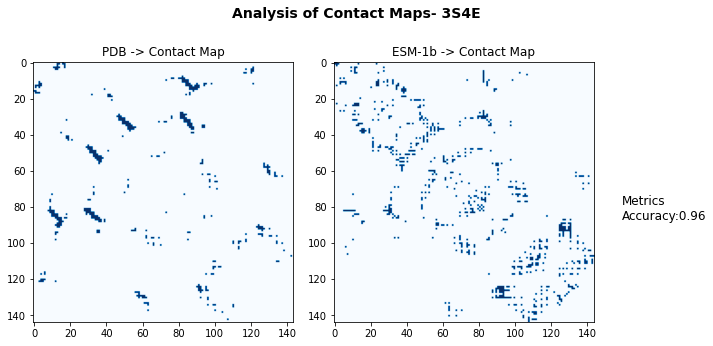

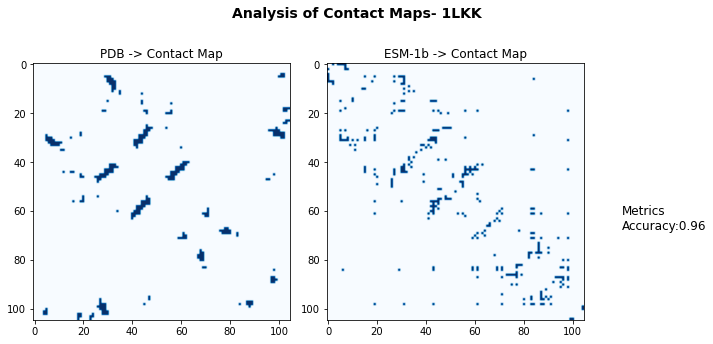

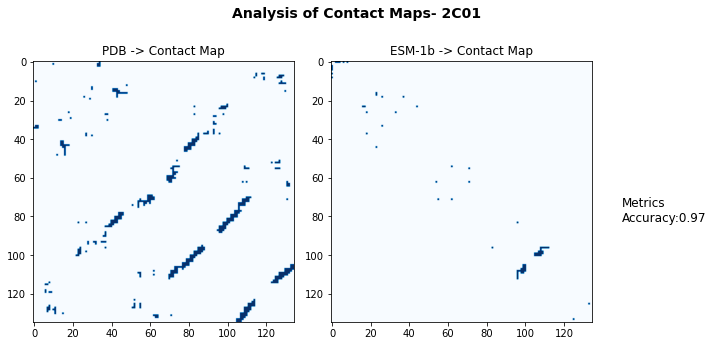

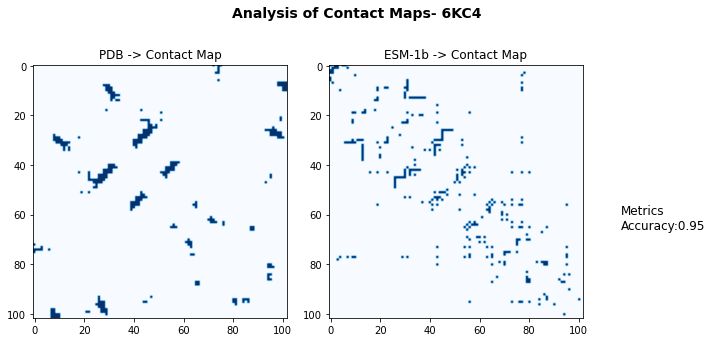

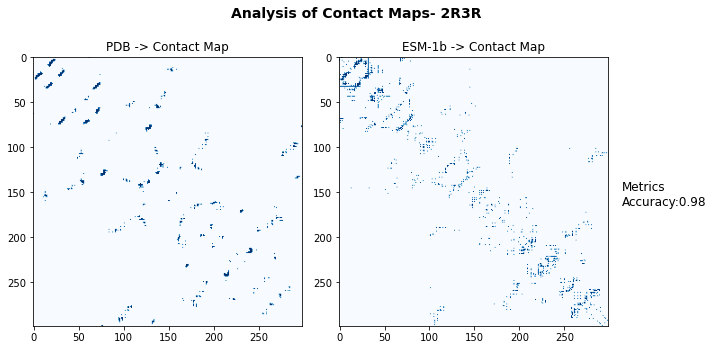

...

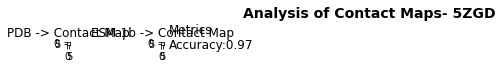

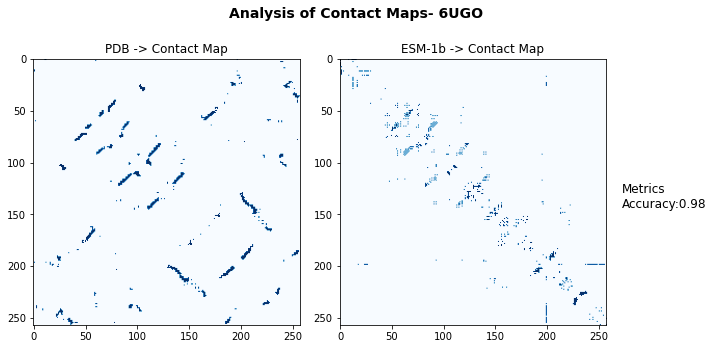

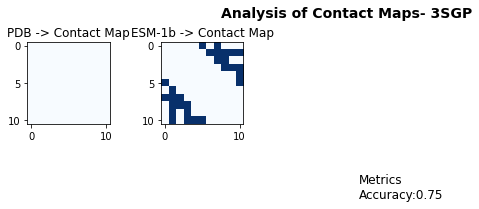

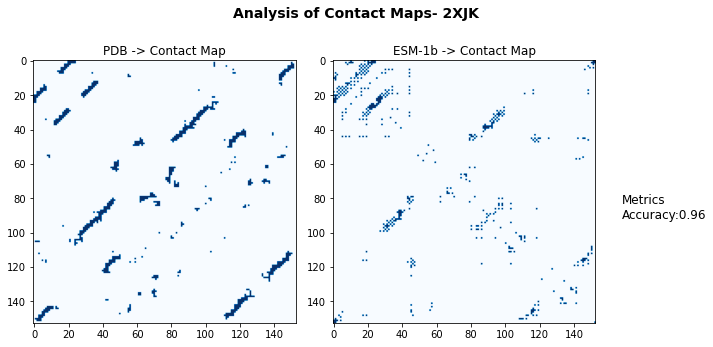

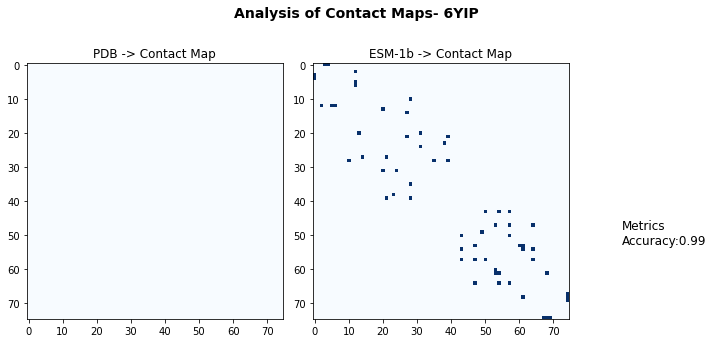

In [15]:
main()

In [44]:
def main1():
    PDB_IDs = pdb_list
    #Load ESM_1b Model
    esm1b,esm1b_batch_converter=load_ESM_1b()
    #Set the path to results
    results_path="/Users/rohan/Desktop/DTI_setup/check_res/" 
    for i,j in enumerate(PDB_IDs):
        print(PDB_IDs[i])
        PDB_IDs_lower = str(PDB_IDs[i]).lower()
        #Set path to PDB files
        PDB_file = f'//Users/rohan/Desktop/DTI_setup/data_main/pdb_files/pdb{PDB_IDs_lower}.ent' 
        #Set path to FASTA files
        fasta_file=f'//Users/rohan/Desktop/DTI_setup/data_main/fasta_files/{PDB_IDs[i]}_1.fasta'
        if os.path.isfile(PDB_file) and os.path.isfile(fasta_file):
            contact_pdb=getContactMap_fromPDB(PDB_file)
            contact_esm=getContactMap_fromESM(esm1b,esm1b_batch_converter,fasta_file)
            if contact_pdb is not None:
                compareContactMaps_Difference(contact_pdb,contact_esm,PDB_IDs[i],results_path)
            else: 
                continue

3KHF
106 99
FASTA and PDB are differnet for3KHF
3LQ3


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


358 401
FASTA and PDB are differnet for3LQ3
3FEG
360 379
FASTA and PDB are differnet for3FEG
6YA6
348 359
FASTA and PDB are differnet for6YA6
2WWE
120 127
FASTA and PDB are differnet for2WWE
2IIM
65 62
FASTA and PDB are differnet for2IIM
4L0N
57 51
FASTA and PDB are differnet for4L0N
3WAR
354 340
FASTA and PDB are differnet for3WAR
2X18
113 119
FASTA and PDB are differnet for2X18
7A22
337 364
FASTA and PDB are differnet for7A22
7A1Z
338 364
FASTA and PDB are differnet for7A1Z
7A2H
336 364
FASTA and PDB are differnet for7A2H
7A1B
345 364
FASTA and PDB are differnet for7A1B
1WYX
68 69
FASTA and PDB are differnet for1WYX
6Z19
335 328
FASTA and PDB are differnet for6Z19
3M9J
130 105
FASTA and PDB are differnet for3M9J
4YPD
316 294
FASTA and PDB are differnet for4YPD
6ELM
105 98
FASTA and PDB are differnet for6ELM
7D0E
109 105
FASTA and PDB are differnet for7D0E
2YJC
233 220
FASTA and PDB are differnet for2YJC
6YZH
360 398
FASTA and PDB are differnet for6YZH
6GY5
309 304
FASTA and PDB are d

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


96 93
FASTA and PDB are differnet for3O46
3I4W
99 104
FASTA and PDB are differnet for3I4W
6TSE
166 169
FASTA and PDB are differnet for6TSE
3S4E
144 144
3G36


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


52 55
FASTA and PDB are differnet for3G36
6EGE
284 302
FASTA and PDB are differnet for6EGE
2QT1


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


202 207
FASTA and PDB are differnet for2QT1
6HOG
132 129
FASTA and PDB are differnet for6HOG
2QFA
140 142
FASTA and PDB are differnet for2QFA
2C60
5 111
FASTA and PDB are differnet for2C60
2XRW
358 371
FASTA and PDB are differnet for2XRW
5GJH
103 100
FASTA and PDB are differnet for5GJH
6G9Z
131 126
FASTA and PDB are differnet for6G9Z
5O8I
128 126
FASTA and PDB are differnet for5O8I
1LKK
105 105
4N6X
95 91
FASTA and PDB are differnet for4N6X
3ZYQ
230 226
FASTA and PDB are differnet for3ZYQ
2C01
135 135
4RFZ
263 283
FASTA and PDB are differnet for4RFZ
3L46


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


94 112
FASTA and PDB are differnet for3L46
5EP6
41 47
FASTA and PDB are differnet for5EP6
1EAZ
103 125
FASTA and PDB are differnet for1EAZ
6KC4
102 102
6KEC
126 127
FASTA and PDB are differnet for6KEC
6KEI
124 127
FASTA and PDB are differnet for6KEI
5K26
82 86
FASTA and PDB are differnet for5K26
6TT2
165 169
FASTA and PDB are differnet for6TT2
4EIH
107 116
FASTA and PDB are differnet for4EIH
5NP5
66 61
FASTA and PDB are differnet for5NP5
6B9X
60 161
FASTA and PDB are differnet for6B9X
3FIA


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


100 121
FASTA and PDB are differnet for3FIA
4LMM
97 91
FASTA and PDB are differnet for4LMM
2R3R
299 299
2R3I
303 299
FASTA and PDB are differnet for2R3I
6HOL
122 123
FASTA and PDB are differnet for6HOL
6J5S
128 128
5ED3
113 128
FASTA and PDB are differnet for5ED3
6TEW
331 364
FASTA and PDB are differnet for6TEW
4FKL
329 299
FASTA and PDB are differnet for4FKL
4EK4
323 299
FASTA and PDB are differnet for4EK4
4EK3
313 299
FASTA and PDB are differnet for4EK3
4P5Q
285 361
FASTA and PDB are differnet for4P5Q
6HMB
350 364
FASTA and PDB are differnet for6HMB
6HMC
344 364
FASTA and PDB are differnet for6HMC
6HMD
349 365
FASTA and PDB are differnet for6HMD
4LDJ
170 170
4OBE
169 170
FASTA and PDB are differnet for4OBE
3LNY
101 96
FASTA and PDB are differnet for3LNY
3WA4


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CD
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


99 98
FASTA and PDB are differnet for3WA4
1OBX


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CO
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


74 79
FASTA and PDB are differnet for1OBX
5P21
166 166
5XRD
208 228
FASTA and PDB are differnet for5XRD
4YDP
88 85
FASTA and PDB are differnet for4YDP
4FH0


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


99 102
FASTA and PDB are differnet for4FH0
7F0W
169 169
6ZBK
117 123
FASTA and PDB are differnet for6ZBK
3EAZ
107 106
FASTA and PDB are differnet for3EAZ
3EAC
106 106
6Q4Q
336 327
FASTA and PDB are differnet for6Q4Q
5AUL
135 109
FASTA and PDB are differnet for5AUL
7L9M
127 127
6SRH
302 301
FASTA and PDB are differnet for6SRH
7M10
72 74
FASTA and PDB are differnet for7M10
6Z36
296 301
FASTA and PDB are differnet for6Z36
6B42
120 129
FASTA and PDB are differnet for6B42
5WA8
118 129
FASTA and PDB are differnet for5WA8
5WA9
121 129
FASTA and PDB are differnet for5WA9
5LR1
209 208
FASTA and PDB are differnet for5LR1
5XRE
207 228
FASTA and PDB are differnet for5XRE
5NYI
213 229
FASTA and PDB are differnet for5NYI
3Q6L
131 152
FASTA and PDB are differnet for3Q6L
4MPA
96 91
FASTA and PDB are differnet for4MPA
2R3Q
298 299
FASTA and PDB are differnet for2R3Q
2WP3
104 109
FASTA and PDB are differnet for2WP3
4RRV
302 311
FASTA and PDB are differnet for4RRV
6I5H
328 339
FASTA and PDB are differnet

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CO
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


347 357
FASTA and PDB are differnet for6G36
6HOI
125 123
FASTA and PDB are differnet for6HOI
5J1S
291 284
FASTA and PDB are differnet for5J1S
2YJ2
231 220
FASTA and PDB are differnet for2YJ2
2YJ9
223 220
FASTA and PDB are differnet for2YJ9
2YJ8
232 220
FASTA and PDB are differnet for2YJ8
2YJB
225 220
FASTA and PDB are differnet for2YJB
2IZX
39 41
FASTA and PDB are differnet for2IZX
5ZCK
4 4


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


4FKU
314 299
FASTA and PDB are differnet for4FKU
5J1T
288 283
FASTA and PDB are differnet for5J1T
2OVJ
207 201
FASTA and PDB are differnet for2OVJ
6RQW
263 256
FASTA and PDB are differnet for6RQW
6RQQ
268 256
FASTA and PDB are differnet for6RQQ
6J65
114 128
FASTA and PDB are differnet for6J65
6DMJ
130 127
FASTA and PDB are differnet for6DMJ
6HYO
150 137
FASTA and PDB are differnet for6HYO
7AJN
127 127
6SE4
131 127
FASTA and PDB are differnet for6SE4
6S25
132 127
FASTA and PDB are differnet for6S25
5O97
130 127
FASTA and PDB are differnet for5O97
6ZED
6ZEL
6ZF9
6I7Y
134 127
FASTA and PDB are differnet for6I7Y
6I7X
130 127
FASTA and PDB are differnet for6I7X
5E0R
131 127
FASTA and PDB are differnet for5E0R
4JL7
91 91
4Q3H
92 92
5KJZ
155 150
FASTA and PDB are differnet for5KJZ
3K05
196 200
FASTA and PDB are differnet for3K05
6ZVO
152 153
FASTA and PDB are differnet for6ZVO
4HYI
275 289
FASTA and PDB are differnet for4HYI
5Y90
327 323
FASTA and PDB are differnet for5Y90
2NZL
351 392
FASTA 

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


65 64
FASTA and PDB are differnet for4X3K
1NTE
82 82
5J80
215 225
FASTA and PDB are differnet for5J80
5J64
213 228
FASTA and PDB are differnet for5J64
7AEW
6FCP
257 236
FASTA and PDB are differnet for6FCP
5P9K
287 279
FASTA and PDB are differnet for5P9K
4HCV
263 269
FASTA and PDB are differnet for4HCV
4HCU
263 269
FASTA and PDB are differnet for4HCU
4HCT
265 269
FASTA and PDB are differnet for4HCT
3KZD
94 94
2RGG
159 166
FASTA and PDB are differnet for2RGG
6Y8E
248 253
FASTA and PDB are differnet for6Y8E
2A2A
314 321
FASTA and PDB are differnet for2A2A
7A2N
59 60
FASTA and PDB are differnet for7A2N
6QUW
171 170
FASTA and PDB are differnet for6QUW
6QUV
170 170
2FE5
101 94
FASTA and PDB are differnet for2FE5
3O3U
580 581
FASTA and PDB are differnet for3O3U
7A2S
63 62
FASTA and PDB are differnet for7A2S
7A2T
62 61
FASTA and PDB are differnet for7A2T
7A2R
63 62
FASTA and PDB are differnet for7A2R
7A2Z
60 60
4XOF
87 76
FASTA and PDB are differnet for4XOF
3KNB
115 100
FASTA and PDB are diffe

/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()


4ZX2


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


344 333
FASTA and PDB are differnet for4ZX2
1W1G
143 151
FASTA and PDB are differnet for1W1G
6G6K
92 94
FASTA and PDB are differnet for6G6K
3IQJ
273 236
FASTA and PDB are differnet for3IQJ
7NPG
251 253
FASTA and PDB are differnet for7NPG
7NPB
247 253
FASTA and PDB are differnet for7NPB
7NP2
246 253
FASTA and PDB are differnet for7NP2
7NND
240 253
FASTA and PDB are differnet for7NND
3A7I
287 303
FASTA and PDB are differnet for3A7I
4UU5
111 90
FASTA and PDB are differnet for4UU5
6M64
205 208
FASTA and PDB are differnet for6M64
3NSZ
333 330
FASTA and PDB are differnet for3NSZ
4QLI
258 236
FASTA and PDB are differnet for4QLI
6T29
7LB1
249 265
FASTA and PDB are differnet for7LB1
3GU6
297 295
FASTA and PDB are differnet for3GU6
3GU4
305 295
FASTA and PDB are differnet for3GU4
2OSS
138 127
FASTA and PDB are differnet for2OSS
3EYI
64 72
FASTA and PDB are differnet for3EYI
3U5L
139 127
FASTA and PDB are differnet for3U5L
1W1H
147 151
FASTA and PDB are differnet for1W1H
3G4E
306 297
FASTA and PD

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element D found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: D
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


328 329
FASTA and PDB are differnet for5ZN0
5ZN1
331 329
FASTA and PDB are differnet for5ZN1
5ZN2
325 329
FASTA and PDB are differnet for5ZN2
5E8X
306 307
FASTA and PDB are differnet for5E8X
3IQV
271 236
FASTA and PDB are differnet for3IQV
3IQU
275 236
FASTA and PDB are differnet for3IQU
6MV4
250 235
FASTA and PDB are differnet for6MV4
5J2X
215 209
FASTA and PDB are differnet for5J2X
4D3P
147 147
5DQY
109 105
FASTA and PDB are differnet for5DQY
5EOP
127 121
FASTA and PDB are differnet for5EOP
3CO1
135 132
FASTA and PDB are differnet for3CO1
7LAY
124 123
FASTA and PDB are differnet for7LAY
1PWA
123 162
FASTA and PDB are differnet for1PWA
5MSA
277 263
FASTA and PDB are differnet for5MSA
5KM2
125 129
FASTA and PDB are differnet for5KM2
4PF4
293 278
FASTA and PDB are differnet for4PF4
3BHY
268 283
FASTA and PDB are differnet for3BHY
3OT3
265 273
FASTA and PDB are differnet for3OT3
2DKO
146 146
3AJ4
133 112
FASTA and PDB are differnet for3AJ4
6N7A
282 304
FASTA and PDB are differnet for6N7A

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


153 162
FASTA and PDB are differnet for1UZK
3P34
236 232
FASTA and PDB are differnet for3P34
7S5A
77 76
FASTA and PDB are differnet for7S5A
4LM4


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


330 345
FASTA and PDB are differnet for4LM4
4LM3
331 345
FASTA and PDB are differnet for4LM3
2QUZ
166 166
1MFG
95 95
6BLN
270 287
FASTA and PDB are differnet for6BLN
6BKW
272 287
FASTA and PDB are differnet for6BKW
6PCL
146 148
FASTA and PDB are differnet for6PCL
6PCK
145 148
FASTA and PDB are differnet for6PCK
3SOV
323 318
FASTA and PDB are differnet for3SOV
5NK5
297 306
FASTA and PDB are differnet for5NK5
5NK6
298 306
FASTA and PDB are differnet for5NK6
5NK4
297 306
FASTA and PDB are differnet for5NK4
5NKA
274 306
FASTA and PDB are differnet for5NKA
5NKG
301 306
FASTA and PDB are differnet for5NKG
5NKH
303 306
FASTA and PDB are differnet for5NKH
5NKE
299 306
FASTA and PDB are differnet for5NKE
5NKF
309 306
FASTA and PDB are differnet for5NKF
5NKC
292 306
FASTA and PDB are differnet for5NKC
5NKD
292 306
FASTA and PDB are differnet for5NKD
4PQW


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


92 91
FASTA and PDB are differnet for4PQW
6FNG
286 306
FASTA and PDB are differnet for6FNG
6FNH
282 306
FASTA and PDB are differnet for6FNH
4RX5
279 271
FASTA and PDB are differnet for4RX5
6Q7C
295 306
FASTA and PDB are differnet for6Q7C
6Q7B
291 306
FASTA and PDB are differnet for6Q7B
6HEY
281 306
FASTA and PDB are differnet for6HEY
6Q7G
291 306
FASTA and PDB are differnet for6Q7G
6Q7E
287 306
FASTA and PDB are differnet for6Q7E
6Q7F
277 306
FASTA and PDB are differnet for6Q7F
4HJP
308 288
FASTA and PDB are differnet for4HJP
3F66
298 298
5MXO
266 236
FASTA and PDB are differnet for5MXO
4WOH
174 166
FASTA and PDB are differnet for4WOH
1I76
165 163
FASTA and PDB are differnet for1I76
5KUP
281 271
FASTA and PDB are differnet for5KUP
4XZF
6HEX
276 306
FASTA and PDB are differnet for6HEX
6HEV
283 306
FASTA and PDB are differnet for6HEV
6HEW
277 306
FASTA and PDB are differnet for6HEW
6HET
275 306
FASTA and PDB are differnet for6HET
6HES
284 306
FASTA and PDB are differnet for6HES
6Q3Y
128 

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


142 141
FASTA and PDB are differnet for1KQ6
6X3P
270 271
FASTA and PDB are differnet for6X3P
3P1N
288 235
FASTA and PDB are differnet for3P1N
5L0S
362 357
FASTA and PDB are differnet for5L0S
4O7A
127 127
4O74
129 127
FASTA and PDB are differnet for4O74
4O72
131 127
FASTA and PDB are differnet for4O72
4O78
136 127
FASTA and PDB are differnet for4O78
3TEM
228 228
6PKF
268 277
FASTA and PDB are differnet for6PKF
4CY7
21 21
6ICG
101 95
FASTA and PDB are differnet for6ICG
6TC2
22 110
FASTA and PDB are differnet for6TC2
4U7H
232 230
FASTA and PDB are differnet for4U7H
5NNE
131 127
FASTA and PDB are differnet for5NNE
5MME
121 119
FASTA and PDB are differnet for5MME
1XOZ
326 364
FASTA and PDB are differnet for1XOZ
1S1P
315 331
FASTA and PDB are differnet for1S1P
5OAZ
59 63
FASTA and PDB are differnet for5OAZ
4Q26
139 136
FASTA and PDB are differnet for4Q26
5I9Y
301 306
FASTA and PDB are differnet for5I9Y
6QHL
252 253
FASTA and PDB are differnet for6QHL
6UYZ
81 83
FASTA and PDB are differnet fo

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


207 190
FASTA and PDB are differnet for4ZGG
3T0H
209 228
FASTA and PDB are differnet for3T0H
7RT1
170 170
7RT5
171 170
FASTA and PDB are differnet for7RT5
5P9M
275 279
FASTA and PDB are differnet for5P9M
5P9L
256 279
FASTA and PDB are differnet for5P9L
5P9I
275 279
FASTA and PDB are differnet for5P9I
5P9J
272 279
FASTA and PDB are differnet for5P9J
4J46
83 86
FASTA and PDB are differnet for4J46
4J45
84 86
FASTA and PDB are differnet for4J45
4J44
85 86
FASTA and PDB are differnet for4J44
4J47
84 86
FASTA and PDB are differnet for4J47
5S9K
295 301
FASTA and PDB are differnet for5S9K
5S8A
300 301
FASTA and PDB are differnet for5S8A
5S81
297 301
FASTA and PDB are differnet for5S81
5S7N
301 301
5S7L
300 301
FASTA and PDB are differnet for5S7L
5S7M
299 301
FASTA and PDB are differnet for5S7M
5S7K
307 301
FASTA and PDB are differnet for5S7K
5S7Y
299 301
FASTA and PDB are differnet for5S7Y
5S7W
300 301
FASTA and PDB are differnet for5S7W
5S85
296 301
FASTA and PDB are differnet for5S85
5S7T
29

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


325 343
FASTA and PDB are differnet for2B69
6HFP
384 393
FASTA and PDB are differnet for6HFP
6HFN
377 393
FASTA and PDB are differnet for6HFN
5F2E
188 170
FASTA and PDB are differnet for5F2E
7S6O
84 77
FASTA and PDB are differnet for7S6O
6OC0
375 369
FASTA and PDB are differnet for6OC0
6PHQ
29 26
FASTA and PDB are differnet for6PHQ
6PHM
34 29
FASTA and PDB are differnet for6PHM
6PHN
30 29
FASTA and PDB are differnet for6PHN
3BER
231 249
FASTA and PDB are differnet for3BER
3GHU
374 316
FASTA and PDB are differnet for3GHU
3GHT
374 316
FASTA and PDB are differnet for3GHT
3GHS
374 316
FASTA and PDB are differnet for3GHS
3GHR
374 316
FASTA and PDB are differnet for3GHR
3Q1I
224 232
FASTA and PDB are differnet for3Q1I
3WHA
211 229
FASTA and PDB are differnet for3WHA
3B28
220 229
FASTA and PDB are differnet for3B28
4QL3
171 170
FASTA and PDB are differnet for4QL3
4TQ9
170 169
FASTA and PDB are differnet for4TQ9
4TQA
171 169
FASTA and PDB are differnet for4TQA
5YOV
130 127
FASTA and PDB are di

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


29 29
6PHL
27 29
FASTA and PDB are differnet for6PHL
6PHI
31 29
FASTA and PDB are differnet for6PHI
4EO7
155 144
FASTA and PDB are differnet for4EO7
4ONM
146 153
FASTA and PDB are differnet for4ONM
5GOD
76 76
5GOB
76 76
5W7W
110 108
FASTA and PDB are differnet for5W7W
2OUS
326 331
FASTA and PDB are differnet for2OUS
6EDF


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


81 79
FASTA and PDB are differnet for6EDF
4QR5
127 125
FASTA and PDB are differnet for4QR5
4QR4
130 125
FASTA and PDB are differnet for4QR4
4QR3
128 125
FASTA and PDB are differnet for4QR3
4NUC
129 127
FASTA and PDB are differnet for4NUC
4NUE
126 127
FASTA and PDB are differnet for4NUE
4NUD
125 127
FASTA and PDB are differnet for4NUD
4UDW
266 258
FASTA and PDB are differnet for4UDW
4UE7
266 258
FASTA and PDB are differnet for4UE7
4UD9
267 259
FASTA and PDB are differnet for4UD9
5AHG
258 258
5AFY
264 258
FASTA and PDB are differnet for5AFY
5AF9
262 258
FASTA and PDB are differnet for5AF9
6FT3
130 127
FASTA and PDB are differnet for6FT3
6FT4
127 127
6FSY
130 127
FASTA and PDB are differnet for6FSY
6VUJ
132 126
FASTA and PDB are differnet for6VUJ
4PCI
129 127
FASTA and PDB are differnet for4PCI
4PCE
134 127
FASTA and PDB are differnet for4PCE
6ZB3
6CZU
137 129
FASTA and PDB are differnet for6CZU
6PS9
137 126
FASTA and PDB are differnet for6PS9
6PRT
135 126
FASTA and PDB are differnet for6

/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


6SZM
296 301
FASTA and PDB are differnet for6SZM
6G3R


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: TE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


393 380
FASTA and PDB are differnet for6G3R
6Y1E
211 210
FASTA and PDB are differnet for6Y1E
5PYW
188 180
FASTA and PDB are differnet for5PYW
5PXB
188 180
FASTA and PDB are differnet for5PXB
5PXA
188 180
FASTA and PDB are differnet for5PXA
5PXL
188 180
FASTA and PDB are differnet for5PXL
5PY5
188 180
FASTA and PDB are differnet for5PY5
5PXT
188 180
FASTA and PDB are differnet for5PXT
5PXS
188 180
FASTA and PDB are differnet for5PXS
5PXN
188 180
FASTA and PDB are differnet for5PXN
5PWG
188 180
FASTA and PDB are differnet for5PWG
5PWF
188 180
FASTA and PDB are differnet for5PWF
5PX4
188 180
FASTA and PDB are differnet for5PX4
5PWS
188 180
FASTA and PDB are differnet for5PWS
5PX2
188 180
FASTA and PDB are differnet for5PX2
5PWR
188 180
FASTA and PDB are differnet for5PWR
5PX6
188 180
FASTA and PDB are differnet for5PX6
5PWU
188 180
FASTA and PDB are differnet for5PWU
5PAG
57 64
FASTA and PDB are differnet for5PAG
5PAV
62 64
FASTA and PDB are differnet for5PAV
5PAS
61 64
FASTA and PDB are 

/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


168 170
FASTA and PDB are differnet for6GJ5
4XO6
335 325
FASTA and PDB are differnet for4XO6
4GQ4


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


485 489
FASTA and PDB are differnet for4GQ4
4GPQ
487 489
FASTA and PDB are differnet for4GPQ
4OG4
476 480
FASTA and PDB are differnet for4OG4
4OG6
478 489
FASTA and PDB are differnet for4OG6
6O53
275 274
FASTA and PDB are differnet for6O53
4C9X
173 158
FASTA and PDB are differnet for4C9X
3EG3
65 63
FASTA and PDB are differnet for3EG3
5LMA
282 277
FASTA and PDB are differnet for5LMA
6DJC
133 132
FASTA and PDB are differnet for6DJC
5XHE
127 113
FASTA and PDB are differnet for5XHE
5KU3
136 126
FASTA and PDB are differnet for5KU3
5NWD
165 191
FASTA and PDB are differnet for5NWD
5NWG
178 191
FASTA and PDB are differnet for5NWG
7ROV
170 189
FASTA and PDB are differnet for7ROV
3I3S
200 166
FASTA and PDB are differnet for3I3S
5Y8C
136 139
FASTA and PDB are differnet for5Y8C
6SQO
63 62
FASTA and PDB are differnet for6SQO
3RFE
119 130
FASTA and PDB are differnet for3RFE
4DLR
173 166
FASTA and PDB are differnet for4DLR
5KHM
126 127
FASTA and PDB are differnet for5KHM
6XDS
509 492
FASTA and PDB ar

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


346 356
FASTA and PDB are differnet for7KT5
1CTQ
166 166
3BUW
9 13
FASTA and PDB are differnet for3BUW
7K5L
131 172
FASTA and PDB are differnet for7K5L
6G0P
128 127
FASTA and PDB are differnet for6G0P
4WJQ
78 83
FASTA and PDB are differnet for4WJQ
5OCG
175 189
FASTA and PDB are differnet for5OCG
5M9O
217 224
FASTA and PDB are differnet for5M9O
2CL6
166 166
2EVW
166 166
6G0Q
125 127
FASTA and PDB are differnet for6G0Q
3RS0
171 166
FASTA and PDB are differnet for3RS0
5C2K


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: AL
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


392 415
FASTA and PDB are differnet for5C2K
7NEL
250 247
FASTA and PDB are differnet for7NEL
6G0O
125 127
FASTA and PDB are differnet for6G0O
5XCT
181 168
FASTA and PDB are differnet for5XCT
5XCQ
177 169
FASTA and PDB are differnet for5XCQ
7KHL
131 149
FASTA and PDB are differnet for7KHL
5JFD
32 36
FASTA and PDB are differnet for5JFD
6T56
31 36
FASTA and PDB are differnet for6T56
6T55
30 36
FASTA and PDB are differnet for6T55
6T53
30 36
FASTA and PDB are differnet for6T53
6YQV
31 36
FASTA and PDB are differnet for6YQV
6YHG
35 36
FASTA and PDB are differnet for6YHG
5A2M
258 258
6TKL
36 36
6TKG
36 36
6Y02
32 36
FASTA and PDB are differnet for6Y02
6VAJ
155 178
FASTA and PDB are differnet for6VAJ
2ZQT
153 163
FASTA and PDB are differnet for2ZQT
3Q27
407 397
FASTA and PDB are differnet for3Q27
6IPY
69 81
FASTA and PDB are differnet for6IPY
5F6Y
178 157
FASTA and PDB are differnet for5F6Y
5F6V
173 157
FASTA and PDB are differnet for5F6V
5F6E
194 157
FASTA and PDB are differnet for5F6E
6HXU
1

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


120 124
FASTA and PDB are differnet for3PP2
6PAF
435 432
FASTA and PDB are differnet for6PAF
6G2N
194 205
FASTA and PDB are differnet for6G2N
4KNN
269 263
FASTA and PDB are differnet for4KNN
2ITK
145 167
FASTA and PDB are differnet for2ITK
2E3N
231 255
FASTA and PDB are differnet for2E3N
2E3P
235 255
FASTA and PDB are differnet for2E3P
7AVC
7ER8
211 216
FASTA and PDB are differnet for7ER8
2C9S
168 153
FASTA and PDB are differnet for2C9S
2C9U
153 153
2C9V
166 153
FASTA and PDB are differnet for2C9V
4HY4
92 115
FASTA and PDB are differnet for4HY4
1DG6
149 191
FASTA and PDB are differnet for1DG6
4AG1
230 226
FASTA and PDB are differnet for4AG1
3NCL
245 241
FASTA and PDB are differnet for3NCL
7KG8


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: AS
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


508 531
FASTA and PDB are differnet for7KG8
4QUJ
259 278
FASTA and PDB are differnet for4QUJ
5CQ2


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


37 90
FASTA and PDB are differnet for5CQ2
3SJM
6QW3
124 119
FASTA and PDB are differnet for6QW3
6NV2
239 236
FASTA and PDB are differnet for6NV2
6QHM
249 253
FASTA and PDB are differnet for6QHM
5MM6
29 36
FASTA and PDB are differnet for5MM6
5MJT
31 36
FASTA and PDB are differnet for5MJT
5I88
131 126
FASTA and PDB are differnet for5I88
5KTU
108 118
FASTA and PDB are differnet for5KTU
4FYO
267 291
FASTA and PDB are differnet for4FYO
5MPZ
115 119
FASTA and PDB are differnet for5MPZ
5MQG
122 119
FASTA and PDB are differnet for5MQG
6I44
629 627
FASTA and PDB are differnet for6I44
5B4O
114 114
5TIU
267 291
FASTA and PDB are differnet for5TIU
4PZ3
167 153
FASTA and PDB are differnet for4PZ3
6RL3
246 253
FASTA and PDB are differnet for6RL3
5R8B
159 153
FASTA and PDB are differnet for5R8B
5R8A
160 153
FASTA and PDB are differnet for5R8A
5R8K
159 153
FASTA and PDB are differnet for5R8K
5R8I
160 153
FASTA and PDB are differnet for5R8I
5R8F
159 153
FASTA and PDB are differnet for5R8F
5R8G
160 153


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CD
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


153 153
5COY
65 65
3UGC
278 295
FASTA and PDB are differnet for3UGC
3TOW
155 152
FASTA and PDB are differnet for3TOW
6O24
232 230
FASTA and PDB are differnet for6O24
4JJE
246 257
FASTA and PDB are differnet for4JJE
3VXE
28 36
FASTA and PDB are differnet for3VXE
1OGW
76 76
1Z89
316 316
6TNQ
70 75
FASTA and PDB are differnet for6TNQ
7NHU
25 21
FASTA and PDB are differnet for7NHU
2H3L
103 103
5NI9
183 189
FASTA and PDB are differnet for5NI9
5NIG
183 189
FASTA and PDB are differnet for5NIG
5NR4
222 230
FASTA and PDB are differnet for5NR4
4IUM
133 142
FASTA and PDB are differnet for4IUM
4N7F
37 38
FASTA and PDB are differnet for4N7F
5YQO
291 306
FASTA and PDB are differnet for5YQO
3SI4
29 36
FASTA and PDB are differnet for3SI4
6T4A
29 36
FASTA and PDB are differnet for6T4A
6T3Q
30 36
FASTA and PDB are differnet for6T3Q
5LCE
31 36
FASTA and PDB are differnet for5LCE
3RMO
30 36
FASTA and PDB are differnet for3RMO
3RM2
31 36
FASTA and PDB are differnet for3RM2
3RM0
29 36
FASTA and PDB are diff

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


293 293
6Y3V
239 253
FASTA and PDB are differnet for6Y3V
3H61


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


315 315
3H63


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


316 315
FASTA and PDB are differnet for3H63
5UGG
272 251
FASTA and PDB are differnet for5UGG
5UGD
251 251
3H62


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


315 315
1I27
73 73
4IGH
376 372
FASTA and PDB are differnet for4IGH
6I42
175 164
FASTA and PDB are differnet for6I42
5HKJ
426 410
FASTA and PDB are differnet for5HKJ
3AP9
155 154
FASTA and PDB are differnet for3AP9
4LNP
67 61
FASTA and PDB are differnet for4LNP
4LN2
72 68
FASTA and PDB are differnet for4LN2
6BCD
211 227
FASTA and PDB are differnet for6BCD
5L0T
364 357
FASTA and PDB are differnet for5L0T
4NIB
21 21
5HRQ
21 21
1BKR
108 109
FASTA and PDB are differnet for1BKR
5TXY
271 260
FASTA and PDB are differnet for5TXY
5KFS
449 435
FASTA and PDB are differnet for5KFS
5KFN
438 435
FASTA and PDB are differnet for5KFN
7M7N
442 435
FASTA and PDB are differnet for7M7N
7M7M
441 435
FASTA and PDB are differnet for7M7M
7M84
461 435
FASTA and PDB are differnet for7M84
7M7T
451 435
FASTA and PDB are differnet for7M7T
4HF3
288 260
FASTA and PDB are differnet for4HF3
6P0I
178 186
FASTA and PDB are differnet for6P0I
7RNU
107 114
FASTA and PDB are differnet for7RNU
6NSV
129 130
FASTA and PDB are d

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: TB
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


290 322
FASTA and PDB are differnet for7NX1
5S8I
123 128
FASTA and PDB are differnet for5S8I
5S8J
131 128
FASTA and PDB are differnet for5S8J
5S8G
123 128
FASTA and PDB are differnet for5S8G
5S8H
124 128
FASTA and PDB are differnet for5S8H
5S8E
124 128
FASTA and PDB are differnet for5S8E
5S8F
124 128
FASTA and PDB are differnet for5S8F
5S8C
124 128
FASTA and PDB are differnet for5S8C
5S8D
124 128
FASTA and PDB are differnet for5S8D
5S8P
122 128
FASTA and PDB are differnet for5S8P
5S8M
125 128
FASTA and PDB are differnet for5S8M
5S8N
124 128
FASTA and PDB are differnet for5S8N
5S8K
124 128
FASTA and PDB are differnet for5S8K
5S8L
125 128
FASTA and PDB are differnet for5S8L
5RKU
124 149
FASTA and PDB are differnet for5RKU
5RKV
124 149
FASTA and PDB are differnet for5RKV
5RKS
124 149
FASTA and PDB are differnet for5RKS
5RKT
125 149
FASTA and PDB are differnet for5RKT
5RKQ
126 149
FASTA and PDB are differnet for5RKQ
5RKR
124 149
FASTA and PDB are differnet for5RKR
5RKO
123 149
FASTA and PD

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


275 293
FASTA and PDB are differnet for3SXB
3SX8
274 293
FASTA and PDB are differnet for3SX8
3SX5
286 293
FASTA and PDB are differnet for3SX5
6LJE
108 101
FASTA and PDB are differnet for6LJE
4EEW
78 88
FASTA and PDB are differnet for4EEW
4WZX


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CO
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


88 95
FASTA and PDB are differnet for4WZX
2IKG
316 316
2IKI
311 316
FASTA and PDB are differnet for2IKI
7JGW
148 158
FASTA and PDB are differnet for7JGW
4GV1
345 340
FASTA and PDB are differnet for4GV1
6KX2
177 181
FASTA and PDB are differnet for6KX2
3WLU


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


142 144
FASTA and PDB are differnet for3WLU
4ICV


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: PR
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


97 85
FASTA and PDB are differnet for4ICV
4OQV
365 377
FASTA and PDB are differnet for4OQV
6HYN
155 138
FASTA and PDB are differnet for6HYN
3CBP
247 256
FASTA and PDB are differnet for3CBP
4WK9
388 377
FASTA and PDB are differnet for4WK9
4WKH
401 377
FASTA and PDB are differnet for4WKH
4WKF
386 377
FASTA and PDB are differnet for4WKF
6XLV
211 204
FASTA and PDB are differnet for6XLV
4WJO
77 83
FASTA and PDB are differnet for4WJO
5UDP
22 21
FASTA and PDB are differnet for5UDP
5E50
116 111
FASTA and PDB are differnet for5E50
1X96
322 316
FASTA and PDB are differnet for1X96
1X98
329 316
FASTA and PDB are differnet for1X98
3ONB
320 315
FASTA and PDB are differnet for3ONB
3ONC
336 315
FASTA and PDB are differnet for3ONC
2QJZ
121 123
FASTA and PDB are differnet for2QJZ
4UZ1
364 383
FASTA and PDB are differnet for4UZ1
4WW6
284 260
FASTA and PDB are differnet for4WW6
6XXC
252 236
FASTA and PDB are differnet for6XXC
6XY5
251 236
FASTA and PDB are differnet for6XY5
6Y18
252 236
FASTA and PDB are 

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


434 435
FASTA and PDB are differnet for5KFZ
7MU3
282 260
FASTA and PDB are differnet for7MU3
5SYA
221 192
FASTA and PDB are differnet for5SYA
5SY9
223 192
FASTA and PDB are differnet for5SY9
5SY6
204 192
FASTA and PDB are differnet for5SY6
4P2G
200 189
FASTA and PDB are differnet for4P2G
3CZA
196 197
FASTA and PDB are differnet for3CZA
7AA7
119 123
FASTA and PDB are differnet for7AA7
6V1B
120 123
FASTA and PDB are differnet for6V1B
7RNS
118 117
FASTA and PDB are differnet for7RNS
6MX3
167 188
FASTA and PDB are differnet for6MX3
3HJ0
131 127
FASTA and PDB are differnet for3HJ0
5MHC
277 236
FASTA and PDB are differnet for5MHC
4HI9
177 179
FASTA and PDB are differnet for4HI9
4HI8
181 179
FASTA and PDB are differnet for4HI8
4FRA
272 294
FASTA and PDB are differnet for4FRA
7B37
351 383
FASTA and PDB are differnet for7B37
7ARG
360 383
FASTA and PDB are differnet for7ARG
7B3F
359 383
FASTA and PDB are differnet for7B3F
5W46
74 76
FASTA and PDB are differnet for5W46
4P36
219 189
FASTA and PDB 

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


109 107
FASTA and PDB are differnet for5KH9
5B8D
112 107
FASTA and PDB are differnet for5B8D
4JJ7
243 275
FASTA and PDB are differnet for4JJ7
3EWY
281 260
FASTA and PDB are differnet for3EWY
3EWX
271 260
FASTA and PDB are differnet for3EWX
4GAI
167 153
FASTA and PDB are differnet for4GAI
7AZ1
254 252
FASTA and PDB are differnet for7AZ1
7AZ2
249 252
FASTA and PDB are differnet for7AZ2
7AXN
256 253
FASTA and PDB are differnet for7AXN
7BG3
250 252
FASTA and PDB are differnet for7BG3
3MRK
292 293
FASTA and PDB are differnet for3MRK
5KTW
114 114
5KTX
115 114
FASTA and PDB are differnet for5KTX
6RA7
307 306
FASTA and PDB are differnet for6RA7
4NFN
295 309
FASTA and PDB are differnet for4NFN
6FEW
294 321
FASTA and PDB are differnet for6FEW
3DN5
321 316
FASTA and PDB are differnet for3DN5
5J0D
117 119
FASTA and PDB are differnet for5J0D
1T41
341 316
FASTA and PDB are differnet for1T41
5MFA
630 697
FASTA and PDB are differnet for5MFA
5L0N
131 135
FASTA and PDB are differnet for5L0N
6TUZ
365 383

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: YB
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


644 608
FASTA and PDB are differnet for3U9W
7L8Q
165 192
FASTA and PDB are differnet for7L8Q
6B6U
544 525
FASTA and PDB are differnet for6B6U
3DJH
114 114
6N6K
209 205
FASTA and PDB are differnet for6N6K
5G4M
201 219
FASTA and PDB are differnet for5G4M
5G4N
199 219
FASTA and PDB are differnet for5G4N
7BF1
6FVF
336 328
FASTA and PDB are differnet for6FVF
3F1N
116 117
FASTA and PDB are differnet for3F1N
2VR8
155 154
FASTA and PDB are differnet for2VR8
7AT9
349 364
FASTA and PDB are differnet for7AT9
6ZEI


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


312 338
FASTA and PDB are differnet for6ZEI
5FAF
135 119
FASTA and PDB are differnet for5FAF
6QHJ
280 264
FASTA and PDB are differnet for6QHJ
6G8L
277 236
FASTA and PDB are differnet for6G8L
6G8J
274 236
FASTA and PDB are differnet for6G8J
6G8K
278 236
FASTA and PDB are differnet for6G8K
6G6X
289 236
FASTA and PDB are differnet for6G6X
6GUK
280 306
FASTA and PDB are differnet for6GUK
1MKK
93 96
FASTA and PDB are differnet for1MKK
6TLS
413 399
FASTA and PDB are differnet for6TLS
5QIT
232 225
FASTA and PDB are differnet for5QIT
5QIR
231 225
FASTA and PDB are differnet for5QIR
5QIQ
231 225
FASTA and PDB are differnet for5QIQ
5QIO
228 225
FASTA and PDB are differnet for5QIO
5QIX
230 225
FASTA and PDB are differnet for5QIX
5QIV
230 225
FASTA and PDB are differnet for5QIV
3HSV
144 145
FASTA and PDB are differnet for3HSV
6AY5
121 115
FASTA and PDB are differnet for6AY5
4R1V
300 291
FASTA and PDB are differnet for4R1V
7SUG
264 297
FASTA and PDB are differnet for7SUG
7SUF
264 297
FASTA and PDB 

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: HG
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


269 260
FASTA and PDB are differnet for5THN
6Q4F
310 306
FASTA and PDB are differnet for6Q4F
6Q3F
302 306
FASTA and PDB are differnet for6Q3F
6Q3C
300 306
FASTA and PDB are differnet for6Q3C
6OMU
282 271
FASTA and PDB are differnet for6OMU
6Q4H
311 306
FASTA and PDB are differnet for6Q4H
6Q4I
301 306
FASTA and PDB are differnet for6Q4I
6Q4D
300 306
FASTA and PDB are differnet for6Q4D
6Q4E
303 306
FASTA and PDB are differnet for6Q4E
6Q4B
301 306
FASTA and PDB are differnet for6Q4B
6Q4J
313 306
FASTA and PDB are differnet for6Q4J
6Q4K
306 306
6Q3B
292 306
FASTA and PDB are differnet for6Q3B
6Q48
290 306
FASTA and PDB are differnet for6Q48
6Q49
309 306
FASTA and PDB are differnet for6Q49
4HBQ
240 206
FASTA and PDB are differnet for4HBQ
3MI2
279 279
6Q4A
305 306
FASTA and PDB are differnet for6Q4A
5A7G
531 532
FASTA and PDB are differnet for5A7G
5YP8
51 60
FASTA and PDB are differnet for5YP8
6FCH
183 178
FASTA and PDB are differnet for6FCH
2VZC
161 131
FASTA and PDB are differnet for2VZC
6

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


117 125
FASTA and PDB are differnet for1H10
6OSH
115 113
FASTA and PDB are differnet for6OSH
6OSN
87 98
FASTA and PDB are differnet for6OSN
6OSV
114 111
FASTA and PDB are differnet for6OSV
4GCJ
304 306
FASTA and PDB are differnet for4GCJ
6E28
99 97
FASTA and PDB are differnet for6E28
1GK7
39 39
1Z0J
169 170
FASTA and PDB are differnet for1Z0J
5MHQ
297 306
FASTA and PDB are differnet for5MHQ
5TZM
95 100
FASTA and PDB are differnet for5TZM
5EHW
273 260
FASTA and PDB are differnet for5EHW
5EHV
272 260
FASTA and PDB are differnet for5EHV
6R8P
359 383
FASTA and PDB are differnet for6R8P
6TJT
160 162
FASTA and PDB are differnet for6TJT
6ZTB
222 219
FASTA and PDB are differnet for6ZTB
7KT0
360 356
FASTA and PDB are differnet for7KT0
7KSZ
351 356
FASTA and PDB are differnet for7KSZ
5KO0
11 11
6VXQ


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


265 293
FASTA and PDB are differnet for6VXQ
4CT2
291 311
FASTA and PDB are differnet for4CT2
6NFH
290 271
FASTA and PDB are differnet for6NFH
5ACK
315 311
FASTA and PDB are differnet for5ACK
5YVN
240 241
FASTA and PDB are differnet for5YVN
1GZ8
291 299
FASTA and PDB are differnet for1GZ8
7B2V
361 383
FASTA and PDB are differnet for7B2V
7B2Y
359 383
FASTA and PDB are differnet for7B2Y
5LVL
317 311
FASTA and PDB are differnet for5LVL
5YP7
44 55
FASTA and PDB are differnet for5YP7
3SX7


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


285 293
FASTA and PDB are differnet for3SX7
3SX3
291 293
FASTA and PDB are differnet for3SX3
5LVM
305 311
FASTA and PDB are differnet for5LVM
6SI3
201 219
FASTA and PDB are differnet for6SI3
6SI1
205 219
FASTA and PDB are differnet for6SI1
6SHZ
207 218
FASTA and PDB are differnet for6SHZ
7OFV
188 185
FASTA and PDB are differnet for7OFV
4XCT
174 157
FASTA and PDB are differnet for4XCT
5W3R
116 114
FASTA and PDB are differnet for5W3R
3CBZ
109 108
FASTA and PDB are differnet for3CBZ
6O4J
11 13
FASTA and PDB are differnet for6O4J
5WAA
120 129
FASTA and PDB are differnet for5WAA
2V0A
160 153
FASTA and PDB are differnet for2V0A
6ZK0
3I0G
268 287
FASTA and PDB are differnet for3I0G
5ZMZ
4 4
6YQM
5BXC


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


303 298
FASTA and PDB are differnet for5BXC
5C49
282 298
FASTA and PDB are differnet for5C49
5LVO
304 311
FASTA and PDB are differnet for5LVO
3FEC
721 707
FASTA and PDB are differnet for3FEC
7PB5
551 546
FASTA and PDB are differnet for7PB5
7P9R
552 546
FASTA and PDB are differnet for7P9R
5LO5
207 229
FASTA and PDB are differnet for5LO5
5MRD
307 310
FASTA and PDB are differnet for5MRD
2YI7
215 229
FASTA and PDB are differnet for2YI7
3NHE
355 348
FASTA and PDB are differnet for3NHE
1LZI


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: HG
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


269 292
FASTA and PDB are differnet for1LZI
1LZJ
267 292
FASTA and PDB are differnet for1LZJ
7RXV
409 417
FASTA and PDB are differnet for7RXV
4XJJ
114 112
FASTA and PDB are differnet for4XJJ
6TN5
6TN4
6W2I
49 51
FASTA and PDB are differnet for6W2I
3MYQ
268 260
FASTA and PDB are differnet for3MYQ
3D06
201 200
FASTA and PDB are differnet for3D06
3D08
200 200
7LIN
141 143
FASTA and PDB are differnet for7LIN
6YHA
272 260
FASTA and PDB are differnet for6YHA
5G4O
204 219
FASTA and PDB are differnet for5G4O
6V4F
95 104
FASTA and PDB are differnet for6V4F
5LL4
277 260
FASTA and PDB are differnet for5LL4
6N6I
196 205
FASTA and PDB are differnet for6N6I
1RG8
141 146
FASTA and PDB are differnet for1RG8
4RI5
304 306
FASTA and PDB are differnet for4RI5
6YQ2
238 236
FASTA and PDB are differnet for6YQ2
6YPY
244 236
FASTA and PDB are differnet for6YPY
6YOW
242 236
FASTA and PDB are differnet for6YOW
7O6M
241 236
FASTA and PDB are differnet for7O6M
7O6J
240 236
FASTA and PDB are differnet for7O6J
7NV4


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


340 356
FASTA and PDB are differnet for7KT2
4OQ4
194 192
FASTA and PDB are differnet for4OQ4
5JO3
323 326
FASTA and PDB are differnet for5JO3
7KTG
360 356
FASTA and PDB are differnet for7KTG
7KTN
365 356
FASTA and PDB are differnet for7KTN
7KT9
360 356
FASTA and PDB are differnet for7KT9
3EZG
194 196
FASTA and PDB are differnet for3EZG
1SOA
203 189
FASTA and PDB are differnet for1SOA
4BCY


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CD
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


152 153
FASTA and PDB are differnet for4BCY
6YOJ
276 282
FASTA and PDB are differnet for6YOJ
7LH7
154 167
FASTA and PDB are differnet for7LH7
3SP7
162 172
FASTA and PDB are differnet for3SP7
4X2F
310 305
FASTA and PDB are differnet for4X2F
6N3X
127 129
FASTA and PDB are differnet for6N3X
6N3V
123 129
FASTA and PDB are differnet for6N3V
3OIU
172 166
FASTA and PDB are differnet for3OIU
3OIW
171 166
FASTA and PDB are differnet for3OIW
4EPV
170 170
6GPO
247 256
FASTA and PDB are differnet for6GPO
7RPZ
169 170
FASTA and PDB are differnet for7RPZ
1UYL
207 236
FASTA and PDB are differnet for1UYL
5BN8
399 388
FASTA and PDB are differnet for5BN8
6PQA
6 6
7A1X


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


172 170
FASTA and PDB are differnet for7A1X
6MS9
163 169
FASTA and PDB are differnet for6MS9
3VHA
219 229
FASTA and PDB are differnet for3VHA
2CIA
112 102
FASTA and PDB are differnet for2CIA
4BTE
190 189
FASTA and PDB are differnet for4BTE
4PQD
105 105
6E5Z
188 191
FASTA and PDB are differnet for6E5Z
4S0Z
206 192
FASTA and PDB are differnet for4S0Z
4MTC
189 189
3VHC
218 229
FASTA and PDB are differnet for3VHC
2YKJ
207 209
FASTA and PDB are differnet for2YKJ
2YKE
207 209
FASTA and PDB are differnet for2YKE
2YK9
207 209
FASTA and PDB are differnet for2YK9
3O0I
208 256
FASTA and PDB are differnet for3O0I
2OR3
198 189
FASTA and PDB are differnet for2OR3
3F71
197 196
FASTA and PDB are differnet for3F71
6GQS
257 256
FASTA and PDB are differnet for6GQS
6GR5
232 256
FASTA and PDB are differnet for6GR5
2GZV
101 114
FASTA and PDB are differnet for2GZV
6AX4
227 237
FASTA and PDB are differnet for6AX4
4N1M
175 168
FASTA and PDB are differnet for4N1M
4N1S
171 165
FASTA and PDB are differnet for4N1S

/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


272 260
FASTA and PDB are differnet for5DRS
3FF3
726 707
FASTA and PDB are differnet for3FF3
6QL2
264 260
FASTA and PDB are differnet for6QL2
6QL3
270 260
FASTA and PDB are differnet for6QL3
6O5I
481 489
FASTA and PDB are differnet for6O5I
6MQT
178 167
FASTA and PDB are differnet for6MQT
1L3K
163 196
FASTA and PDB are differnet for1L3K
4U1P
110 122
FASTA and PDB are differnet for4U1P
5M33
97 101
FASTA and PDB are differnet for5M33
6T5B
170 170
6T5V
171 169
FASTA and PDB are differnet for6T5V
6TAN
189 170
FASTA and PDB are differnet for6TAN
4QTA
350 361
FASTA and PDB are differnet for4QTA
6ZCS
272 299
FASTA and PDB are differnet for6ZCS
5J0F
114 114
4PZZ
170 170
4Q03
170 170
4Q01
166 169
FASTA and PDB are differnet for4Q01
4X9V
229 237
FASTA and PDB are differnet for4X9V
4X9R
237 237
6G0G
136 127
FASTA and PDB are differnet for6G0G
6BQA
102 102
4ZZN
340 350
FASTA and PDB are differnet for4ZZN
3K0N
196 165
FASTA and PDB are differnet for3K0N
3K0M
181 165
FASTA and PDB are differnet for3K

/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


6GGF
201 219
FASTA and PDB are differnet for6GGF
5O1I
205 219
FASTA and PDB are differnet for5O1I
6GGC
205 219
FASTA and PDB are differnet for6GGC
6GGD
202 219
FASTA and PDB are differnet for6GGD
6GGB
206 219
FASTA and PDB are differnet for6GGB
5O1G
205 219
FASTA and PDB are differnet for5O1G
5O1D
206 219
FASTA and PDB are differnet for5O1D
5O1E
209 219
FASTA and PDB are differnet for5O1E
5O1B
203 219
FASTA and PDB are differnet for5O1B
5O1A
207 219
FASTA and PDB are differnet for5O1A
5O1H
205 219
FASTA and PDB are differnet for5O1H
5AOK
207 219
FASTA and PDB are differnet for5AOK
5LUD
170 165
FASTA and PDB are differnet for5LUD
5NOY
173 165
FASTA and PDB are differnet for5NOY
5NOW
168 165
FASTA and PDB are differnet for5NOW
5NOX
170 165
FASTA and PDB are differnet for5NOX
5NOU
166 165
FASTA and PDB are differnet for5NOU
5NOS
168 165
FASTA and PDB are differnet for5NOS
5NOT
170 165
FASTA and PDB are differnet for5NOT
6TKK
163 158
FASTA and PDB are differnet for6TKK
6SLG
336 381
FASTA a

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element D found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: D
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


135 135
5EI4
133 127
FASTA and PDB are differnet for5EI4
6SWN
4UIZ
136 127
FASTA and PDB are differnet for4UIZ
4UIY
129 127
FASTA and PDB are differnet for4UIY
4CL9
127 127
6Z7M
6DL2
130 128
FASTA and PDB are differnet for6DL2
5A5S
131 127
FASTA and PDB are differnet for5A5S
1T7H
18 18
4UYD
130 153
FASTA and PDB are differnet for4UYD
6UWX
127 127
6UVJ
127 127
4CFQ
88 91
FASTA and PDB are differnet for4CFQ
6TS3
78 73
FASTA and PDB are differnet for6TS3
7JKY
133 127
FASTA and PDB are differnet for7JKY
7JKX
129 127
FASTA and PDB are differnet for7JKX
7JKW
130 127
FASTA and PDB are differnet for7JKW
5LJ2
131 127
FASTA and PDB are differnet for5LJ2
6FNX
135 127
FASTA and PDB are differnet for6FNX
7A9U
5XI4
125 124
FASTA and PDB are differnet for5XI4
6JJ5
125 125
6JJ6
125 125
7M16
123 127
FASTA and PDB are differnet for7M16
7P6W
7P6V
4WHW
124 127
FASTA and PDB are differnet for4WHW
5S96
124 149
FASTA and PDB are differnet for5S96
4Q7Z
237 250
FASTA and PDB are differnet for4Q7Z
5QS8
177 172


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


270 263
FASTA and PDB are differnet for3U2U
7LCU
494 490
FASTA and PDB are differnet for7LCU
3P6C
143 139
FASTA and PDB are differnet for3P6C
1X97
328 316
FASTA and PDB are differnet for1X97
4XZH
326 316
FASTA and PDB are differnet for4XZH
4QX4
326 316
FASTA and PDB are differnet for4QX4
1PWL
321 316
FASTA and PDB are differnet for1PWL
4OEL
285 370
FASTA and PDB are differnet for4OEL
5IPC
120 129
FASTA and PDB are differnet for5IPC
5IPE
117 129
FASTA and PDB are differnet for5IPE
4GGC
313 318
FASTA and PDB are differnet for4GGC
3K8Y
168 166
FASTA and PDB are differnet for3K8Y
4AOH
135 124
FASTA and PDB are differnet for4AOH
4GRR
119 116
FASTA and PDB are differnet for4GRR
4GRP
126 118
FASTA and PDB are differnet for4GRP
6YF2


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CD
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


120 109
FASTA and PDB are differnet for6YF2
6YF3
118 109
FASTA and PDB are differnet for6YF3
6YF1
116 109
FASTA and PDB are differnet for6YF1
5M9Q
137 124
FASTA and PDB are differnet for5M9Q
5M9R
127 124
FASTA and PDB are differnet for5M9R
5MG7
215 200
FASTA and PDB are differnet for5MG7
5MCT
220 200
FASTA and PDB are differnet for5MCT
5WDQ
198 170
FASTA and PDB are differnet for5WDQ
5WDP
199 166
FASTA and PDB are differnet for5WDP
6RWU
265 253
FASTA and PDB are differnet for6RWU
5H5Q
170 169
FASTA and PDB are differnet for5H5Q
5H5R
178 169
FASTA and PDB are differnet for5H5R
4TNS
118 151
FASTA and PDB are differnet for4TNS
2RJ5
295 294
FASTA and PDB are differnet for2RJ5
4A3P
217 217
7AC9
31 36
FASTA and PDB are differnet for7AC9
5EDC
143 133
FASTA and PDB are differnet for5EDC
5EDB
143 134
FASTA and PDB are differnet for5EDB
6YVK
310 260
FASTA and PDB are differnet for6YVK
6YVN
310 260
FASTA and PDB are differnet for6YVN
6YVL
310 260
FASTA and PDB are differnet for6YVL
6YVM
310 260
F

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


347 298
FASTA and PDB are differnet for6GX2
5NJ9
510 495
FASTA and PDB are differnet for5NJ9
5NJA
509 495
FASTA and PDB are differnet for5NJA
6T52
28 36
FASTA and PDB are differnet for6T52
6T3M
32 36
FASTA and PDB are differnet for6T3M
3U98
29 36
FASTA and PDB are differnet for3U98
6I51
30 36
FASTA and PDB are differnet for6I51
6YSJ
30 36
FASTA and PDB are differnet for6YSJ
6YN3
29 36
FASTA and PDB are differnet for6YN3
6YMP
30 36
FASTA and PDB are differnet for6YMP
6YHJ
38 36
FASTA and PDB are differnet for6YHJ
6YB6
32 36
FASTA and PDB are differnet for6YB6
6Y9H
31 36
FASTA and PDB are differnet for6Y9H
5IBP
258 278
FASTA and PDB are differnet for5IBP
6GMC
383 368
FASTA and PDB are differnet for6GMC
6GMB
379 362
FASTA and PDB are differnet for6GMB
3EXX


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


23 21
FASTA and PDB are differnet for3EXX
3W7Z
21 21
6VET
20 21
FASTA and PDB are differnet for6VET
4X5W
197 193
FASTA and PDB are differnet for4X5W
6S34
23 21
FASTA and PDB are differnet for6S34
6VER
25 21
FASTA and PDB are differnet for6VER
4XC4
21 21
5USV
22 21
FASTA and PDB are differnet for5USV
5UU2
22 21
FASTA and PDB are differnet for5UU2
5URT
22 21
FASTA and PDB are differnet for5URT
5USP
24 21
FASTA and PDB are differnet for5USP
5UOZ
23 21
FASTA and PDB are differnet for5UOZ
3U8R
28 30
FASTA and PDB are differnet for3U8R
4AJX
26 21
FASTA and PDB are differnet for4AJX
4R0U
7 7
6GV0


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


22 21
FASTA and PDB are differnet for6GV0
5I29
142 144
FASTA and PDB are differnet for5I29
2BVR
250 252
FASTA and PDB are differnet for2BVR
2BVS
251 259
FASTA and PDB are differnet for2BVS
2ZFF
29 36
FASTA and PDB are differnet for2ZFF
6OD3
62 62
4ZNN
10 10


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


4RIL
11 11
5C4M
182 193
FASTA and PDB are differnet for5C4M
2JKH
246 241
FASTA and PDB are differnet for2JKH
4QKZ
165 163
FASTA and PDB are differnet for4QKZ
2J30
245 250
FASTA and PDB are differnet for2J30
2J32
240 250
FASTA and PDB are differnet for2J32
3KL6
235 241
FASTA and PDB are differnet for3KL6
5SVY
61 50
FASTA and PDB are differnet for5SVY
4FKA


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


22 21
FASTA and PDB are differnet for4FKA
6GBW
33 36
FASTA and PDB are differnet for6GBW
6ROT
32 36
FASTA and PDB are differnet for6ROT
5JZY
32 36
FASTA and PDB are differnet for5JZY
3P17
28 36
FASTA and PDB are differnet for3P17
5R7W
157 153
FASTA and PDB are differnet for5R7W
6Y8I
152 153
FASTA and PDB are differnet for6Y8I
4HK2
75 78
FASTA and PDB are differnet for4HK2
5NHU
36 36
6YSX
30 36
FASTA and PDB are differnet for6YSX
4IBY
215 200
FASTA and PDB are differnet for4IBY
5A7B
205 219
FASTA and PDB are differnet for5A7B
4AGQ
202 219
FASTA and PDB are differnet for4AGQ
4AGO
200 219
FASTA and PDB are differnet for4AGO
3U8O
32 30
FASTA and PDB are differnet for3U8O
1HE4
206 206
5BT3
117 116
FASTA and PDB are differnet for5BT3
6NE2
198 200
FASTA and PDB are differnet for6NE2
5WL1
291 300
FASTA and PDB are differnet for5WL1
4GQR
497 496
FASTA and PDB are differnet for4GQR
4Z47
201 204
FASTA and PDB are differnet for4Z47
1C5L
36 36
2CF8
257 257
6SBO
247 260
FASTA and PDB are differnet f

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: AL
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


193 193
5TXD
6 6
3PZZ


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


6 6
3Q2X


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


6 6
5TOG


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


154 78
FASTA and PDB are differnet for5TOG
7CAP
77 76
FASTA and PDB are differnet for7CAP
4JTR
328 331
FASTA and PDB are differnet for4JTR
4JQA
324 331
FASTA and PDB are differnet for4JQA
6D3Y
248 247
FASTA and PDB are differnet for6D3Y
5VOS
11 11
7KJM


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


87 85
FASTA and PDB are differnet for7KJM
1KJL
142 146
FASTA and PDB are differnet for1KJL
6UYR
78 83
FASTA and PDB are differnet for6UYR
6UYP
78 83
FASTA and PDB are differnet for6UYP
6OIZ
15 15
6NB9
15 15
5TOF
138 78
FASTA and PDB are differnet for5TOF
6T5G
331 316
FASTA and PDB are differnet for6T5G
6T27
348 316
FASTA and PDB are differnet for6T27
6IBE
307 286
FASTA and PDB are differnet for6IBE
6X8H
152 168
FASTA and PDB are differnet for6X8H
4PUW
329 316
FASTA and PDB are differnet for4PUW
6TUF
347 316
FASTA and PDB are differnet for6TUF
6TUC
356 316
FASTA and PDB are differnet for6TUC
2AXI
92 115
FASTA and PDB are differnet for2AXI
6YBM
167 165
FASTA and PDB are differnet for6YBM
4Q2Q
94 102
FASTA and PDB are differnet for4Q2Q
6K39
151 152
FASTA and PDB are differnet for6K39
5ONQ


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CD
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


326 316
FASTA and PDB are differnet for5ONQ
5ONR
323 316
FASTA and PDB are differnet for5ONR
5ONP
325 316
FASTA and PDB are differnet for5ONP
5HOB
45 50
FASTA and PDB are differnet for5HOB
4D6A
142 133
FASTA and PDB are differnet for4D6A
6Q0M
96 94
FASTA and PDB are differnet for6Q0M
6Q0N
100 93
FASTA and PDB are differnet for6Q0N
6F4P


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


269 255
FASTA and PDB are differnet for6F4P
2RK6
196 192
FASTA and PDB are differnet for2RK6
5HOC
45 50
FASTA and PDB are differnet for5HOC
6T7Q
349 316
FASTA and PDB are differnet for6T7Q
2AGT
389 319
FASTA and PDB are differnet for2AGT
3T42
331 319
FASTA and PDB are differnet for3T42
3LZ3
335 316
FASTA and PDB are differnet for3LZ3
3LQL
332 316
FASTA and PDB are differnet for3LQL
3LD5
322 316
FASTA and PDB are differnet for3LD5
3LBO
338 316
FASTA and PDB are differnet for3LBO
4NIN
7 7
6F8O


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


331 316
FASTA and PDB are differnet for6F8O
6F84
333 316
FASTA and PDB are differnet for6F84
6F82
344 316
FASTA and PDB are differnet for6F82
4OWZ
134 134
6BXX
6 6


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


2RK4
193 197
FASTA and PDB are differnet for2RK4
2RK3
199 197
FASTA and PDB are differnet for2RK3
2R8U


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MO
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


131 268
FASTA and PDB are differnet for2R8U
5EH7
272 260
FASTA and PDB are differnet for5EH7
5EH8
274 260
FASTA and PDB are differnet for5EH8
5EH5
275 260
FASTA and PDB are differnet for5EH5
6AFC
192 189
FASTA and PDB are differnet for6AFC
6AFJ
189 189
6AFD
191 189
FASTA and PDB are differnet for6AFD
6AF9
195 189
FASTA and PDB are differnet for6AF9
6AF7
203 189
FASTA and PDB are differnet for6AF7
2WD2
255 259
FASTA and PDB are differnet for2WD2
4CQ0
278 260
FASTA and PDB are differnet for4CQ0
6GL8
148 172
FASTA and PDB are differnet for6GL8
5RJI
125 149
FASTA and PDB are differnet for5RJI
3MRG
315 293
FASTA and PDB are differnet for3MRG
6ZEG


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


334 338
FASTA and PDB are differnet for6ZEG
5UL6
59 58
FASTA and PDB are differnet for5UL6
3D25
274 274
2WNV
139 134
FASTA and PDB are differnet for2WNV
4NIO
7 7


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


3UVC
177 164
FASTA and PDB are differnet for3UVC
5YBY
250 251
FASTA and PDB are differnet for5YBY
4ZSD
168 164
FASTA and PDB are differnet for4ZSD
5CBT
164 165
FASTA and PDB are differnet for5CBT
6ALC
114 114
6F78
322 318
FASTA and PDB are differnet for6F78
5I8G
233 264
FASTA and PDB are differnet for5I8G
5V8Q
259 249
FASTA and PDB are differnet for5V8Q
6AY3
123 115
FASTA and PDB are differnet for6AY3
6AXQ
113 114
FASTA and PDB are differnet for6AXQ
5W0E
116 148
FASTA and PDB are differnet for5W0E
6RT6
6RT4
6EW6
127 123
FASTA and PDB are differnet for6EW6
5ZGD
9 9
4GYX


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


28 31
FASTA and PDB are differnet for4GYX
6UGO
257 257
6I3E


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: HG
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


309 265
FASTA and PDB are differnet for6I3E
6X8O
30 27
FASTA and PDB are differnet for6X8O
6E78
120 115
FASTA and PDB are differnet for6E78
6E72
119 115
FASTA and PDB are differnet for6E72
6T2K
349 383
FASTA and PDB are differnet for6T2K
6T2H
365 383
FASTA and PDB are differnet for6T2H
6SJA
386 383
FASTA and PDB are differnet for6SJA
7B9N
345 383
FASTA and PDB are differnet for7B9N
7B9I
358 383
FASTA and PDB are differnet for7B9I
7B84
359 383
FASTA and PDB are differnet for7B84
7B7Y
344 383
FASTA and PDB are differnet for7B7Y
7B86
349 383
FASTA and PDB are differnet for7B86
7B8C
359 383
FASTA and PDB are differnet for7B8C
7B8A
367 383
FASTA and PDB are differnet for7B8A
7B8L
351 383
FASTA and PDB are differnet for7B8L
7B8M
346 383
FASTA and PDB are differnet for7B8M
7B45
347 383
FASTA and PDB are differnet for7B45
7B3G
346 383
FASTA and PDB are differnet for7B3G
7BDA
344 383
FASTA and PDB are differnet for7BDA
7BDF
347 383
FASTA and PDB are differnet for7BDF
7BDC
347 383
FASTA and PDB 

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


290 294
FASTA and PDB are differnet for2RJ4
4AVS
211 204
FASTA and PDB are differnet for4AVS
3D32
125 119
FASTA and PDB are differnet for3D32
7AES
276 260
FASTA and PDB are differnet for7AES
5EXN
241 238
FASTA and PDB are differnet for5EXN
2PZN
354 316
FASTA and PDB are differnet for2PZN
4QR6
324 316
FASTA and PDB are differnet for4QR6
4Q7B
324 315
FASTA and PDB are differnet for4Q7B
4PUU
325 316
FASTA and PDB are differnet for4PUU
4RPQ
318 315
FASTA and PDB are differnet for4RPQ
4YU1
334 316
FASTA and PDB are differnet for4YU1
4PRR
327 315
FASTA and PDB are differnet for4PRR
4PR4
328 315
FASTA and PDB are differnet for4PR4
4NKC
320 315
FASTA and PDB are differnet for4NKC
2PQ8


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


266 278
FASTA and PDB are differnet for2PQ8
6YIP
75 75
4M5S
93 87
FASTA and PDB are differnet for4M5S
1RYO
325 327
FASTA and PDB are differnet for1RYO
4YS1
332 316
FASTA and PDB are differnet for4YS1
6D40
253 248
FASTA and PDB are differnet for6D40
2PDG
314 316
FASTA and PDB are differnet for2PDG
2PDH
315 316
FASTA and PDB are differnet for2PDH
2PDL
315 316
FASTA and PDB are differnet for2PDL
1Z3N
359 319
FASTA and PDB are differnet for1Z3N
3LQG
315 316
FASTA and PDB are differnet for3LQG
5KL3
89 93
FASTA and PDB are differnet for5KL3
4PK3
189 198
FASTA and PDB are differnet for4PK3
4PK2
208 198
FASTA and PDB are differnet for4PK2
4Q6S
89 87
FASTA and PDB are differnet for4Q6S
2XG3
167 138
FASTA and PDB are differnet for2XG3
4UE1
107 114
FASTA and PDB are differnet for4UE1
1A7S
221 225
FASTA and PDB are differnet for1A7S
6HN3


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


190 176
FASTA and PDB are differnet for6HN3
7NUS
87 96
FASTA and PDB are differnet for7NUS
6Q9L
94 96
FASTA and PDB are differnet for6Q9L
6Q9O
97 96
FASTA and PDB are differnet for6Q9O


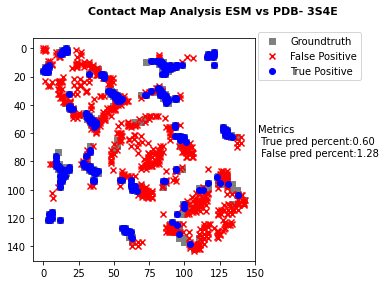

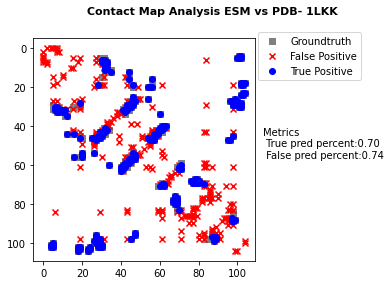

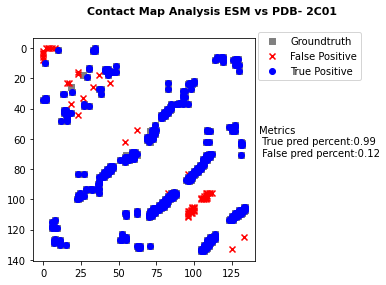

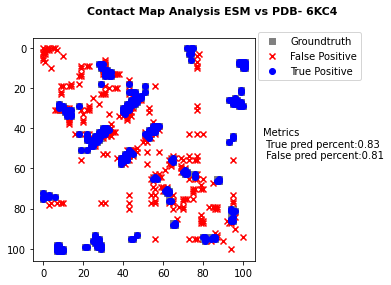

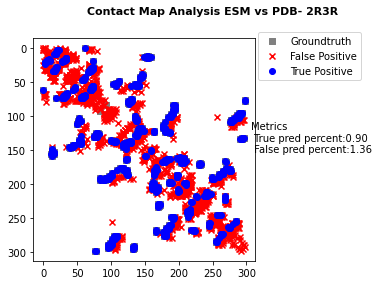

...

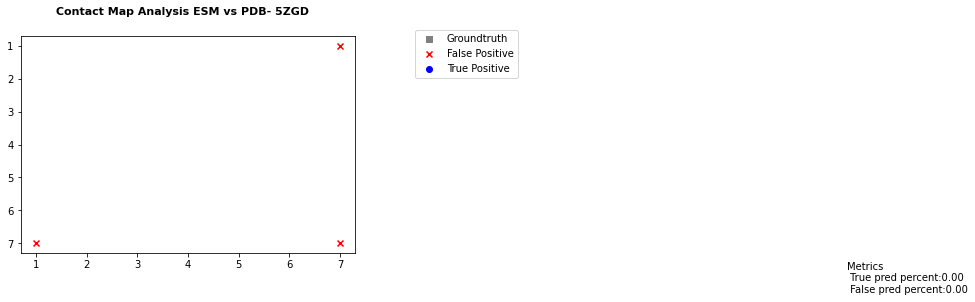

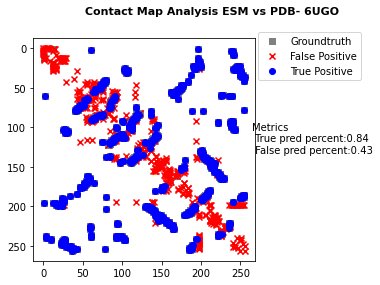

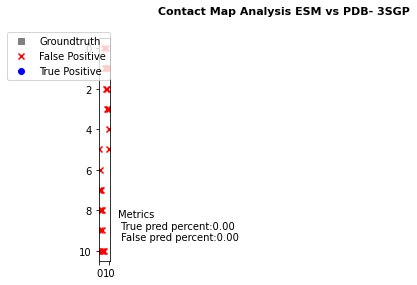

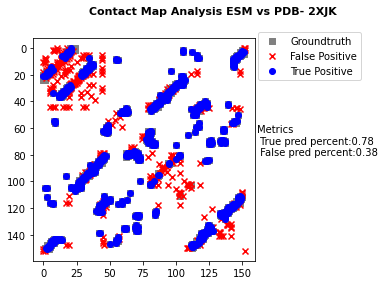

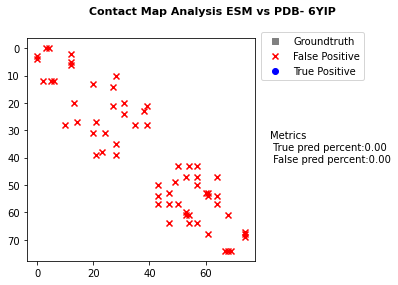

In [45]:
main1()